In [1]:
import sys
sys.path.append('../')

In [1]:
from rumboost.utils import *
from rumboost.utility_smoothing import *
from rumboost.rumboost import *
from rumboost.dataset import *
from rumboost.models import *
from rumboost.utility_plotting import *
from rumboost.post_process import *

import lightgbm

# RUMBoost

This notebook shows features implemented in RUMBoost through an example on the LPMC dataset.

# Example 1: LPMC

In [2]:
#load dataset
LPMC_train, LPMC_test, folds = load_preprocess_LPMC()

#load model
LPMC_model = LPMC(LPMC_train)

## Training a RUMBoost model

In [3]:
#parameters
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':3000,
          'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

#features and label column names

features = [f for f in LPMC_train.columns if f != "choice"]

label = "choice"
#create lightgbm dataset
lgb_train_set = lightgbm.Dataset(LPMC_train[features], label=LPMC_train[label], free_raw_data=False)
lgb_test_set = lightgbm.Dataset(LPMC_test[features], label=LPMC_test[label], free_raw_data=False)

## Training with an MNL model

### Cross-validation

Cross-validation within RUMBoost is currently not implemented. But it is possible to train 5 RUMBoost models on 5 different folds, and average their results to find the number of trees needed. Note: the numbers of trees may vary from the paper because of the randomness when creating the folds.

In [4]:
rum_structure = bio_to_rumboost(LPMC_model)

In [5]:
ce_loss = 0
num_trees = 0
for i, (train_idx, test_idx) in enumerate(folds):
    train_set = lgb_train_set.subset(sorted(train_idx))
    test_set = lgb_train_set.subset(sorted(test_idx))

    param = copy.deepcopy(params)

    #build the RUM constraints from the biogeme model. You can also specify a dictionary directly
    rum_structure = bio_to_rumboost(LPMC_model)

    print('-'*50 + '\n')
    print(f'Iteration {i+1}')
    LPMC_model_trained = rum_train(param,train_set,rum_structure=rum_structure, valid_sets = [test_set])
    ce_loss += LPMC_model_trained.best_score
    num_trees += LPMC_model_trained.best_iteration
    print('-'*50 + '\n')
    print(f'Best cross entropy loss: {LPMC_model_trained.best_score}')
    print(f'Best number of trees: {LPMC_model_trained.best_iteration}')

ce_loss = ce_loss/5
num_trees = num_trees/5
print('-'*50 + '\n')
print(f'Cross validation negative cross entropy loss: {ce_loss}')
print(f'With a number of trees on average of {num_trees}')

--------------------------------------------------

Iteration 1


c:\Users\ucesnjs\anaconda32\envs\dddm\Lib\site-packages\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
Early stopping at iteration 1338, with a best score on test set of 0.6547915343105425, and on train set of 0.6387787299830016
--------------------------------------------------

Best cross entropy loss: 0.6547915343105425
Best number of trees: 1338
--------------------------------------------------

Iteration 2


c:\Users\ucesnjs\anaconda32\envs\dddm\Lib\site-packages\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
Early stopping at iteration 1540, with a best score on test set of 0.6412724866887559, and on train set of 0.6408871059824639
--------------------------------------------------

Best cross entropy loss: 0.6412724866887559
Best number of trees: 1540
--------------------------------------------------

Iteration 3
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function


c:\Users\ucesnjs\anaconda32\envs\dddm\Lib\site-packages\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Early stopping at iteration 947, with a best score on test set of 0.6578905380266721, and on train set of 0.6403509924820917
--------------------------------------------------

Best cross entropy loss: 0.6578905380266721
Best number of trees: 947
--------------------------------------------------

Iteration 4


c:\Users\ucesnjs\anaconda32\envs\dddm\Lib\site-packages\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
Early stopping at iteration 1370, with a best score on test set of 0.6625909474992793, and on train set of 0.6365132406072292
--------------------------------------------------

Best cross entropy loss: 0.6625909474992793
Best number of trees: 1370
--------------------------------------------------

Iteration 5


c:\Users\ucesnjs\anaconda32\envs\dddm\Lib\site-packages\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
[LightGBM] [Info] Using self-defined objective function
Early stopping at iteration 1185, with a best score on test set of 0.6652871073880208, and on train set of 0.6364183314350806
--------------------------------------------------

Best cross entropy loss: 0.6652871073880208
Best number of trees: 1185
--------------------------------------------------

Cross validation negative cross entropy loss: 0.6563665227826541
With a number of trees on average of 1276.0


### Testing

In [6]:
rum_structure = bio_to_rumboost(LPMC_model)
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':1276,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

LPMC_model_fully_trained = rum_train(params, lgb_train_set, rum_structure)

preds = LPMC_model_fully_trained.predict(lgb_test_set)

ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Finished loading model, total used 1276 iterations
Finished loading model, total used 1276 iterations
Finished loading model, total used 1276 iterations
Finished loading model, total used 1276 iterations
--------------------------------------------------
Final negative cross-entropy on the test set: 0.6736637302293347


## Plotting utilities


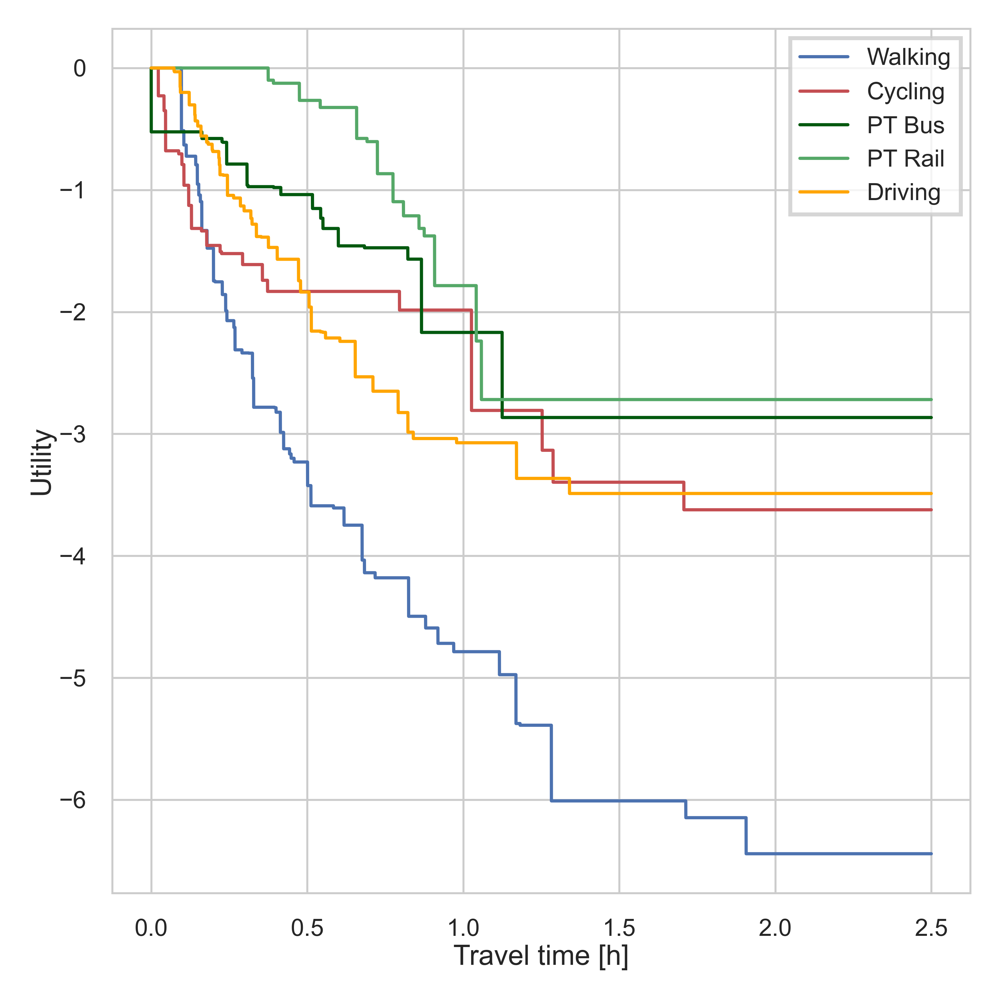

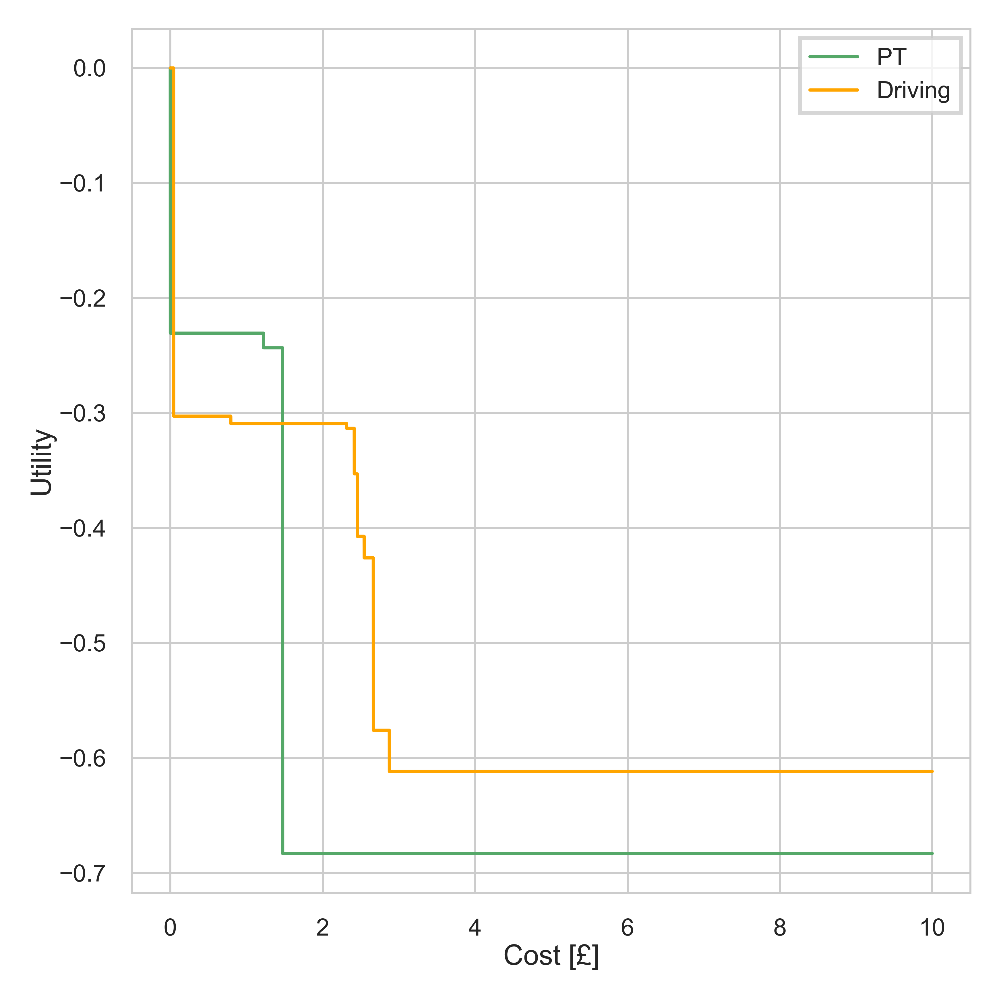

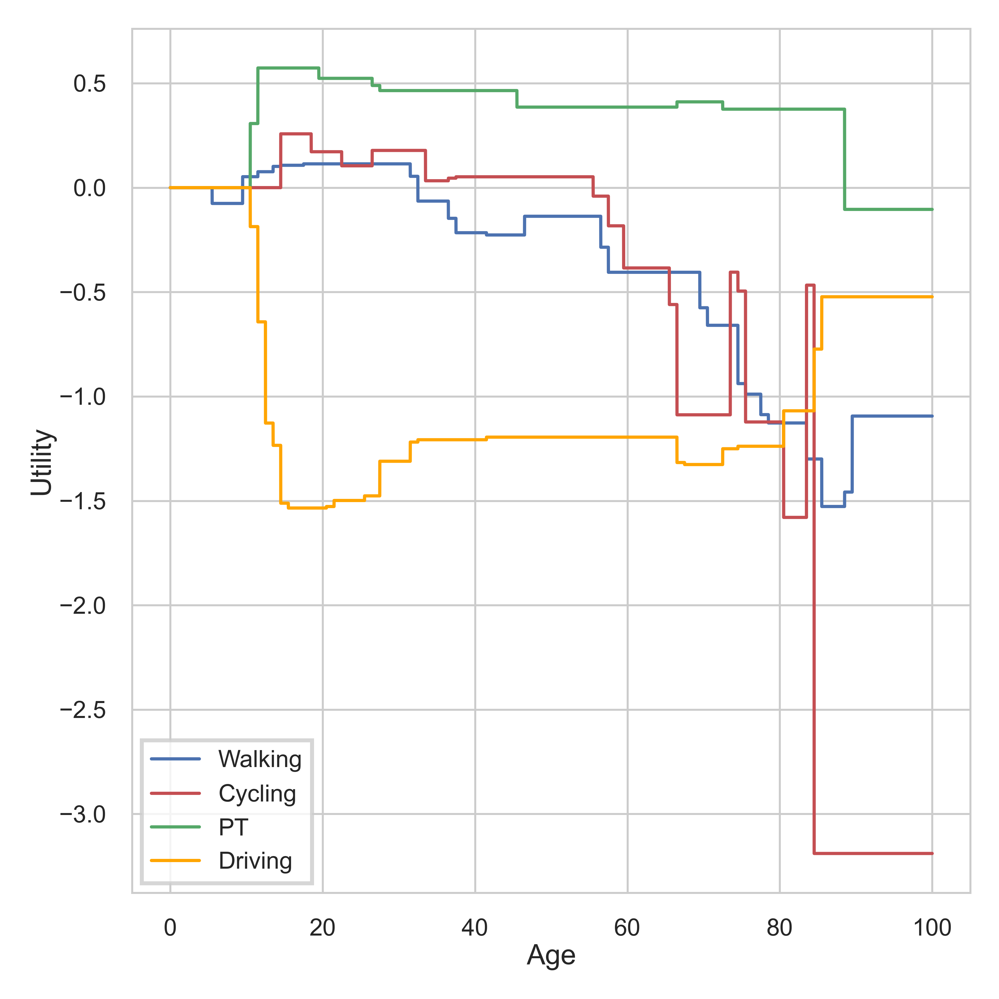

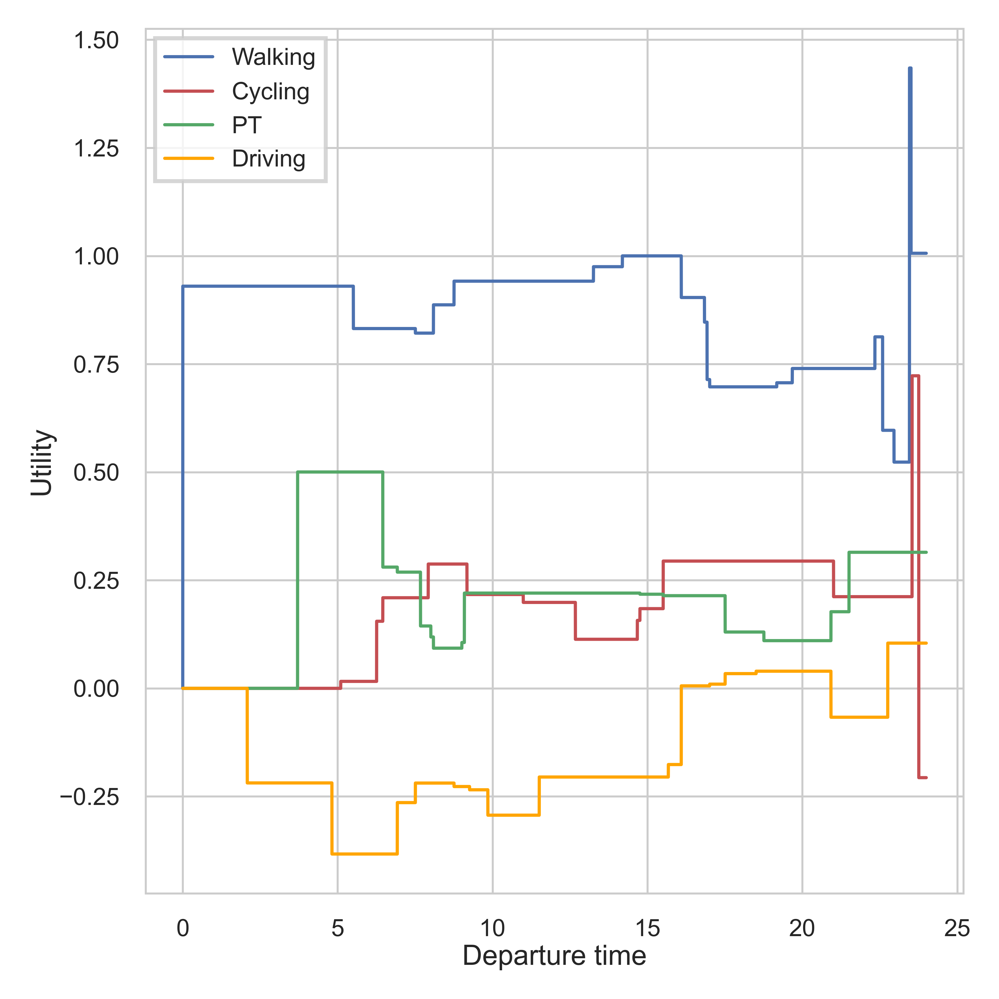

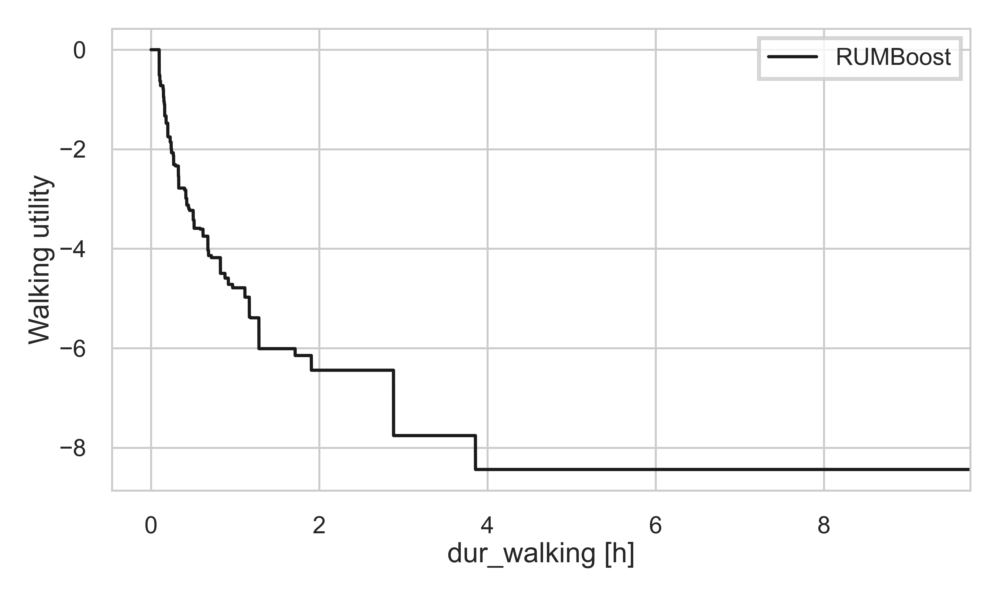

...

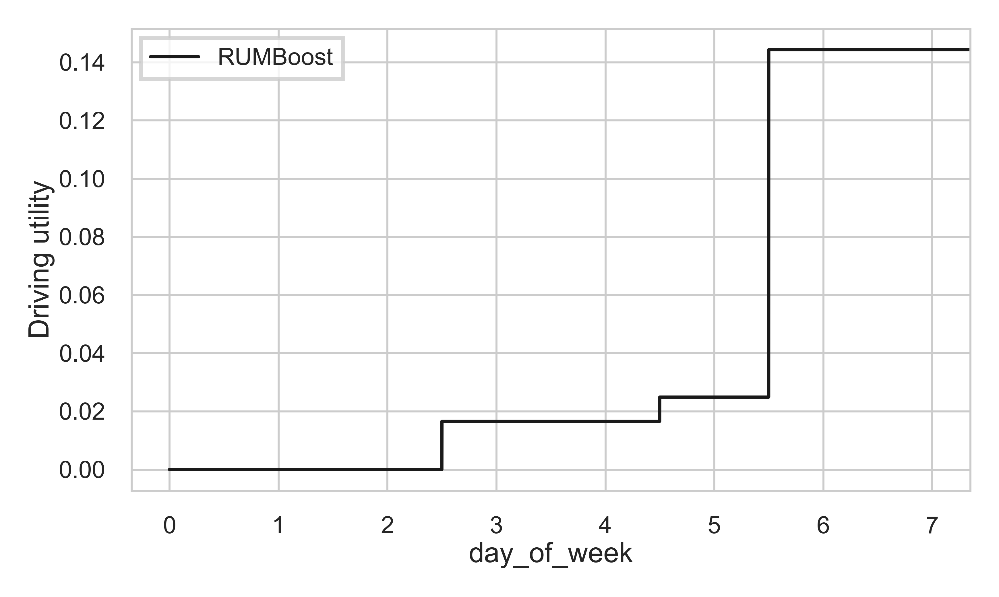

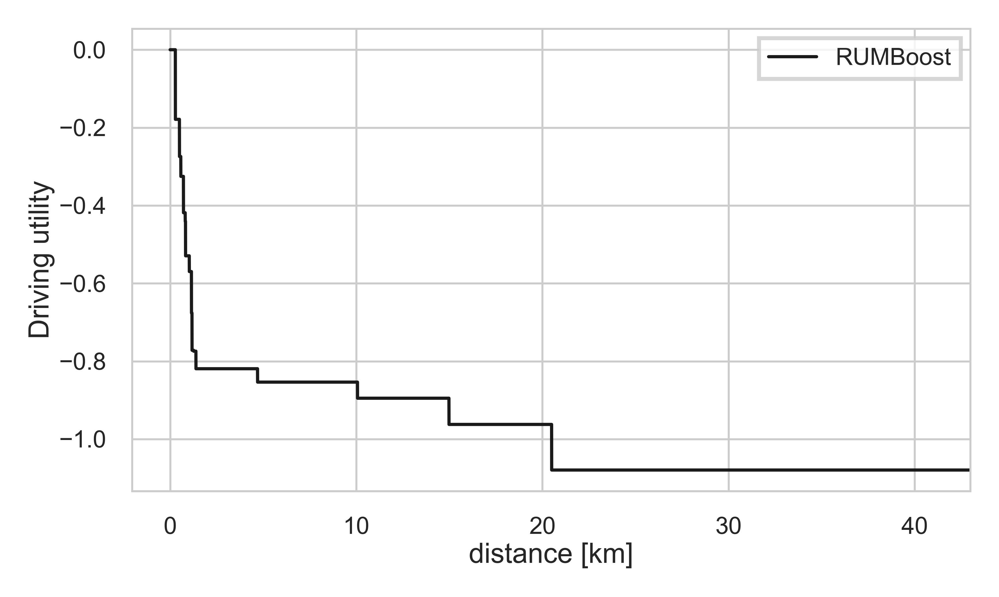

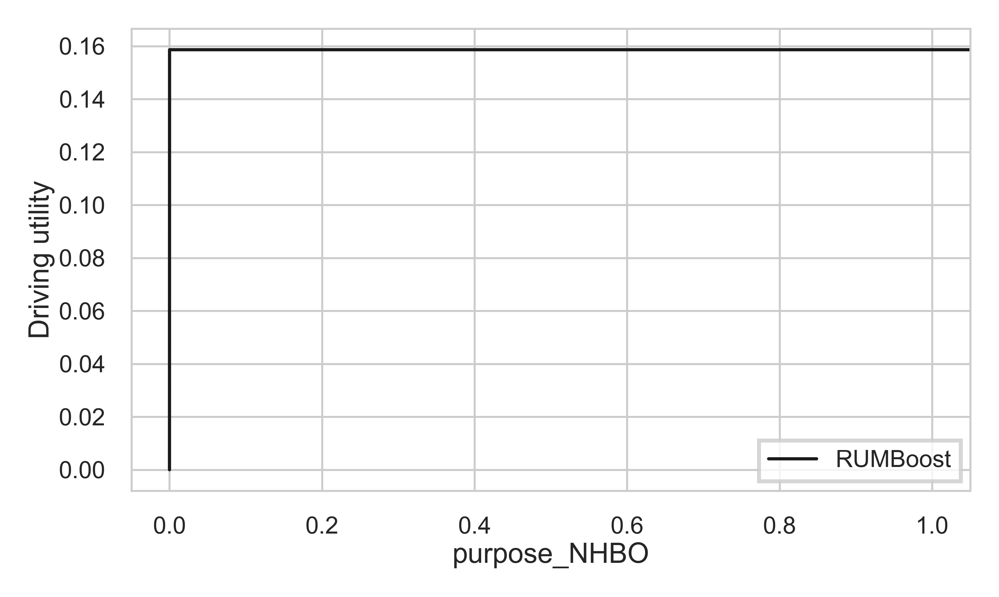

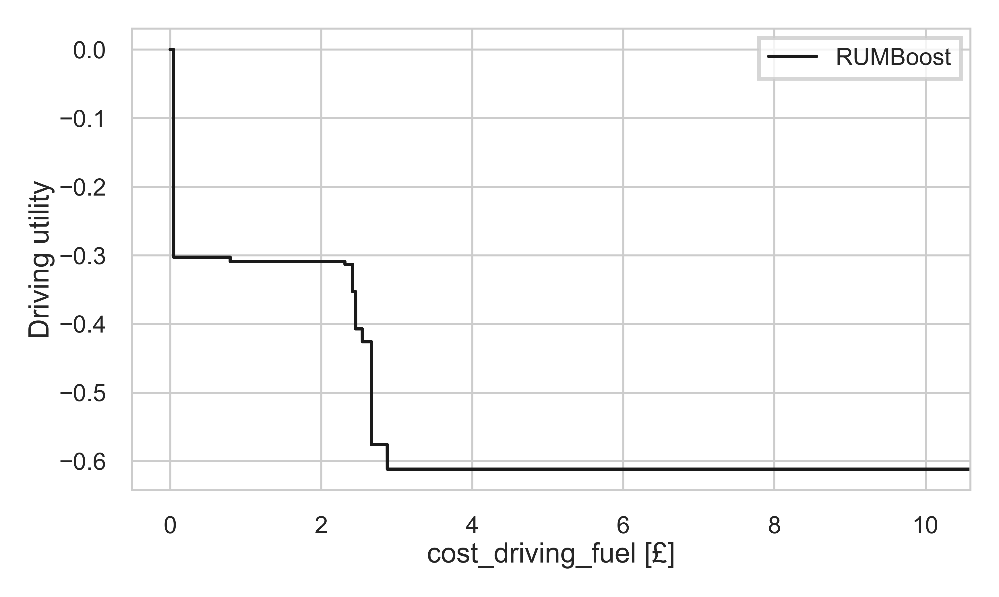

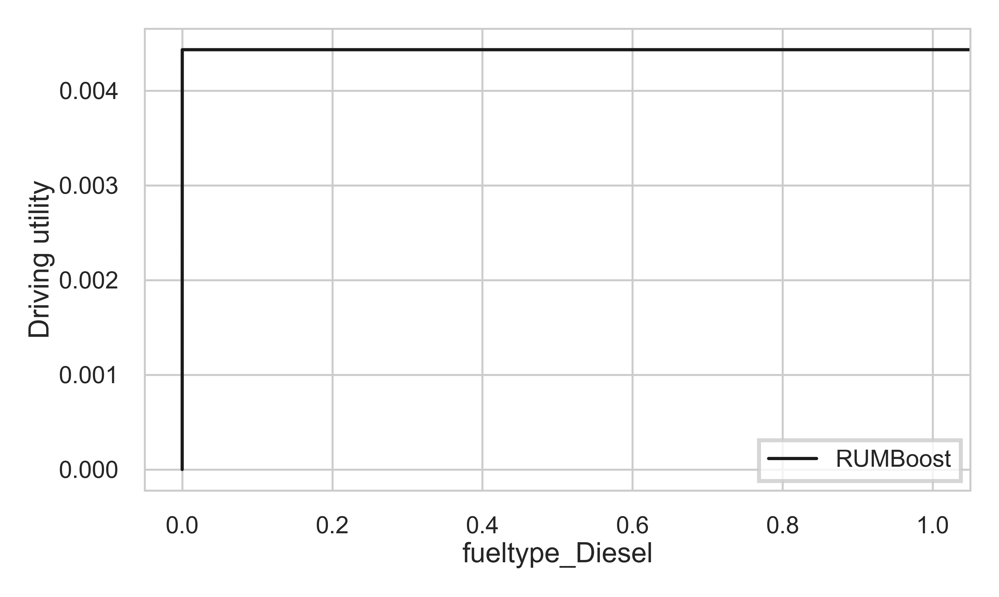

In [8]:
utility_names = {'0':'Walking', '1':'Cycling', '2':'Public Transport', '3': 'Driving'}

plot_parameters(LPMC_model_fully_trained, LPMC_train, utility_names, asc_normalised=True, only_1d=False, save_figure=False)

## Utility smoothing

The utility is smoothed using piece-wise cubic hermite splines. Each spline are linked through knots where they have equal values and derivatives. The number of knots is treated as a hyperparameter and is optimised with hyperopt, while their positions are locally optimised using a local optimizer (scipy.minimize). In this example, for computational purposes, the optimal number of knots is taken from a previous hyperparameter search and only their position is optimized. Note that the code used for the hyperparameter search is in comments, and it is possible to use it by uncommenting the appropriate lines.

In [9]:
import hyperopt

In [10]:
# param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
#                     'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
#             '1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
#                     'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
#             '2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
#                     #'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
#                     'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
#                     'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
#                     'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
#                     'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
#                     'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
#             '3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
#                     'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
#                     'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
#                     'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
#                 }

#number of splines (number of knots-1)
param_space = {'0':{'distance': 5,
                    'dur_walking': 5},
            '1':{'distance': 5,
                    'dur_cycling': 5},
            '2':{'cost_transit': 2,
                    #'distance': 5,
                    'dur_pt_access': 3,
                    'dur_pt_bus': 3,
                    'dur_pt_int_waiting': 7,
                    'dur_pt_int_walking': 6,
                    'dur_pt_rail': 2},
            '3':{'cost_driving_fuel': 5,
                    'distance': 3,
                    'driving_traffic_percent': 7,
                    'dur_driving': 3}
                }

In [20]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC()
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 50, optimize = True, deg_freedom=True, n_iter=1)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

In [21]:
# n=25
n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/1 [00:00<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\scipy\optimize\_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Iteration limit reached    (Exit mode 9)             
            Current function value:                  
71593.47363880971                                    
            Iterations:                              
50                                                   
            Function evaluations:                    
2458                                                 
            Gradient evaluations:                    
48                                                   
1/1:71593.47363880971 with knots at: [ 0.95717964  9.02996486 22.8508837  25.37585004  0.71324514  2.17387713
  4.53771013  6.37144282  2.09579978  8.03835122 12.16538718 24.65747448
  0.31172481  0.84219135  1.40503657  2.46455405  2.53837711  0.27817017
  0.49829621  0.64287616  1.09898311  0.09167981  0.1632993   0.19485346
  0.20907956  0.33081399  0.52310831  0.04957955  0.05629823  0.06426128
  0.07350546  0.1260462   0.63490641  1.10758643  5.43315975  6.21844261
  7.00967444  7.81689716  3.73490207 20

## Cross-entropy on the test set

This can vary from the value displayed in the paper due to randomness in the optimisation solver

In [22]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

# spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
#                     'dur_walking': int(best_classifier['dur_walking'])},
#             '1':{'distance': int(best_classifier['distance_1']),
#                     'dur_cycling': int(best_classifier['dur_cycling'])},
#             '2':{'cost_transit': int(best_classifier['cost_transit']),
#                     #'distance': int(best_classifier['distance_2']),
#                     'dur_pt_access': int(best_classifier['dur_pt_access']),
#                     'dur_pt_bus': int(best_classifier['dur_pt_bus']),
#                     'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
#                     'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
#                     'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
#             '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
#                     'distance': int(best_classifier['distance_3']),
#                     'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
#                     'dur_driving': int(best_classifier['dur_driving'])}
#                 }


spline_collection = {'0':{'distance': 5,
                    'dur_walking': 5},
            '1':{'distance': 5,
                    'dur_cycling': 5},
            '2':{'cost_transit': 2,
                    #'distance': 5,
                    'dur_pt_access': 3,
                    'dur_pt_bus': 3,
                    'dur_pt_int_waiting': 7,
                    'dur_pt_int_walking': 6,
                    'dur_pt_rail': 2},
            '3':{'cost_driving_fuel': 5,
                    'distance': 3,
                    'driving_traffic_percent': 7,
                    'dur_driving': 3}
                }

spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.6732300573483379


## Splines plot

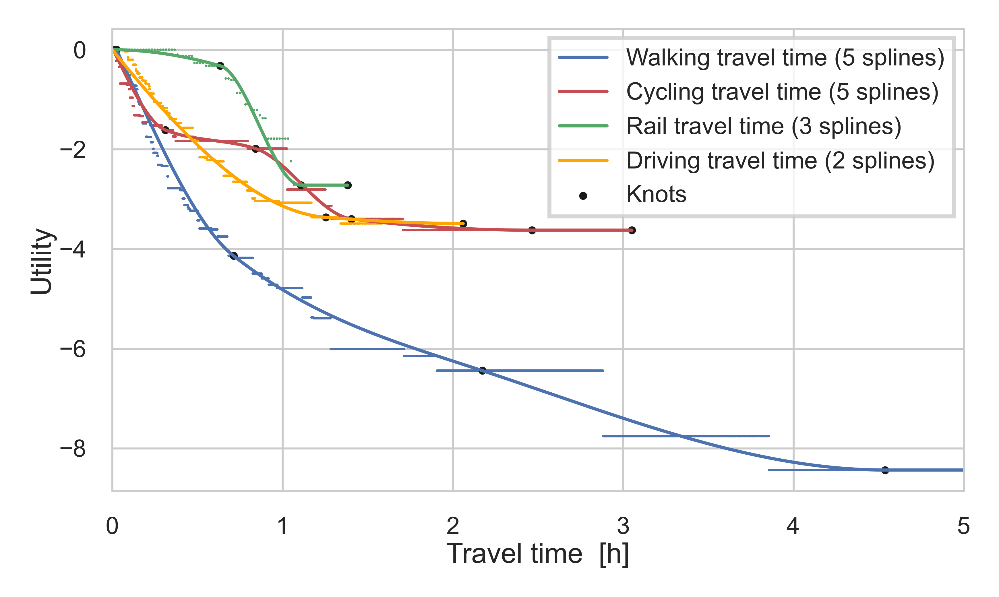

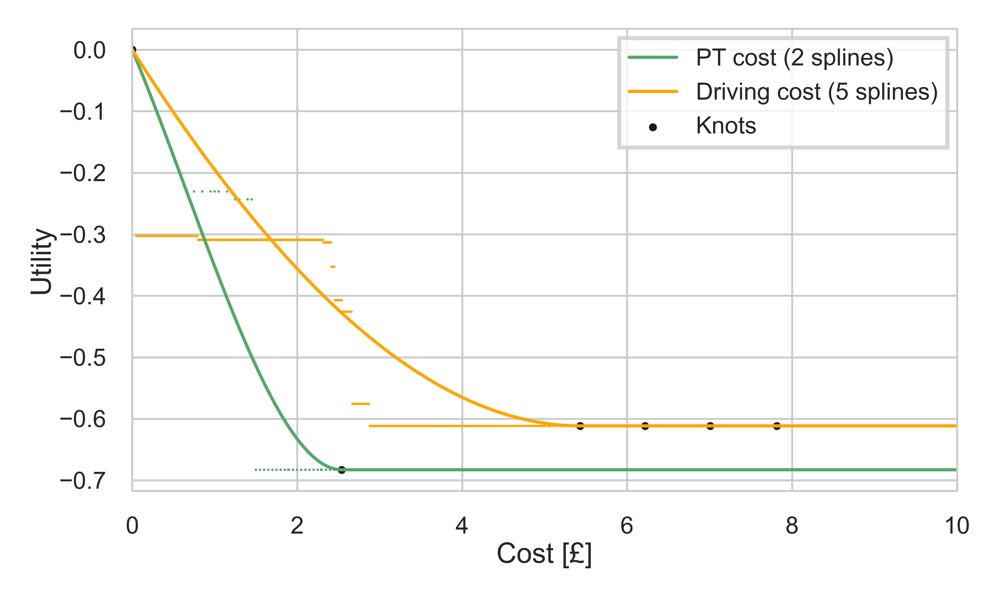

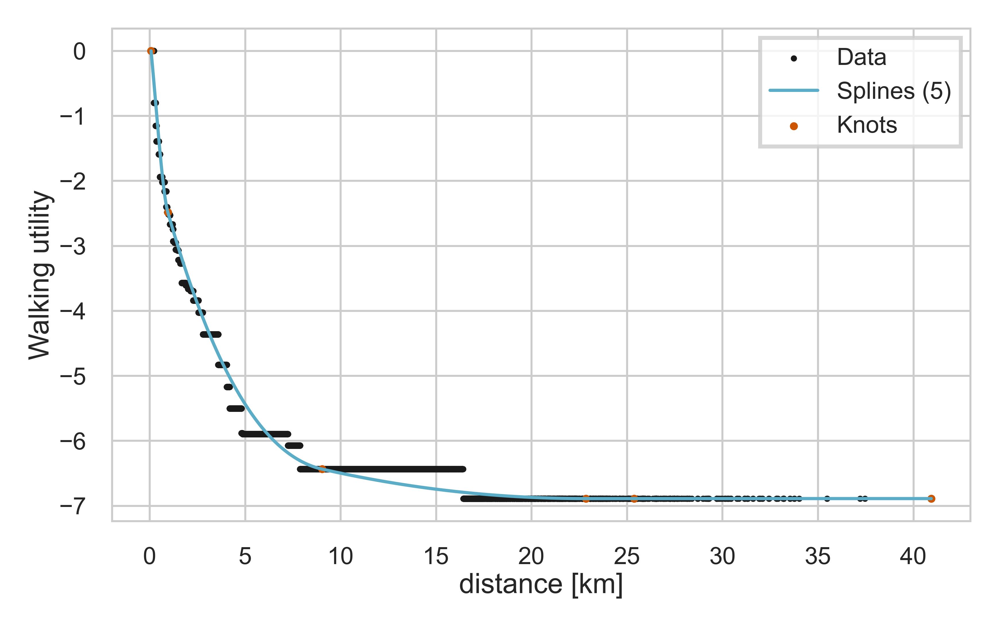

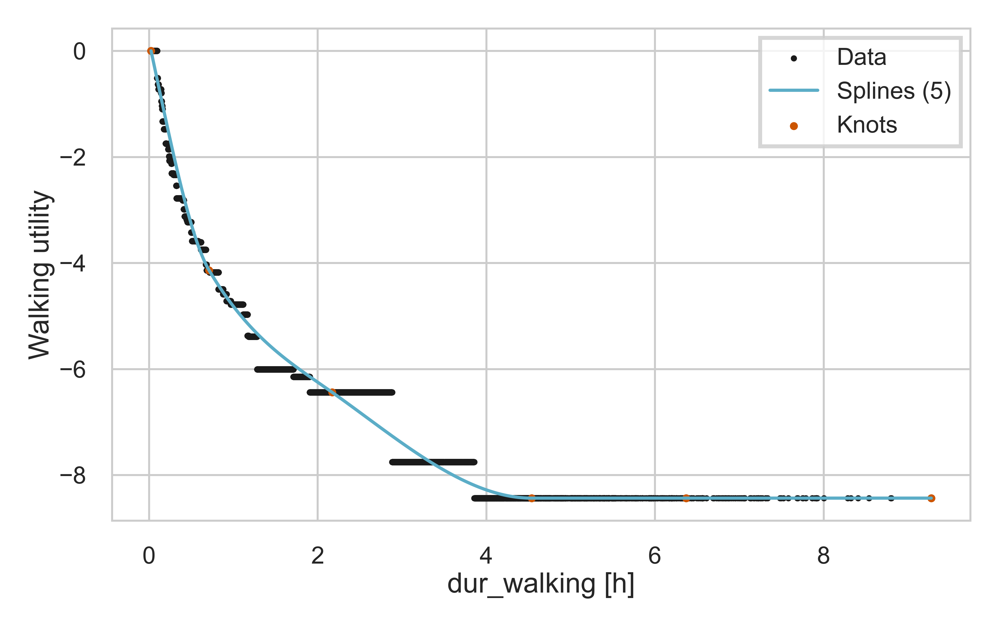

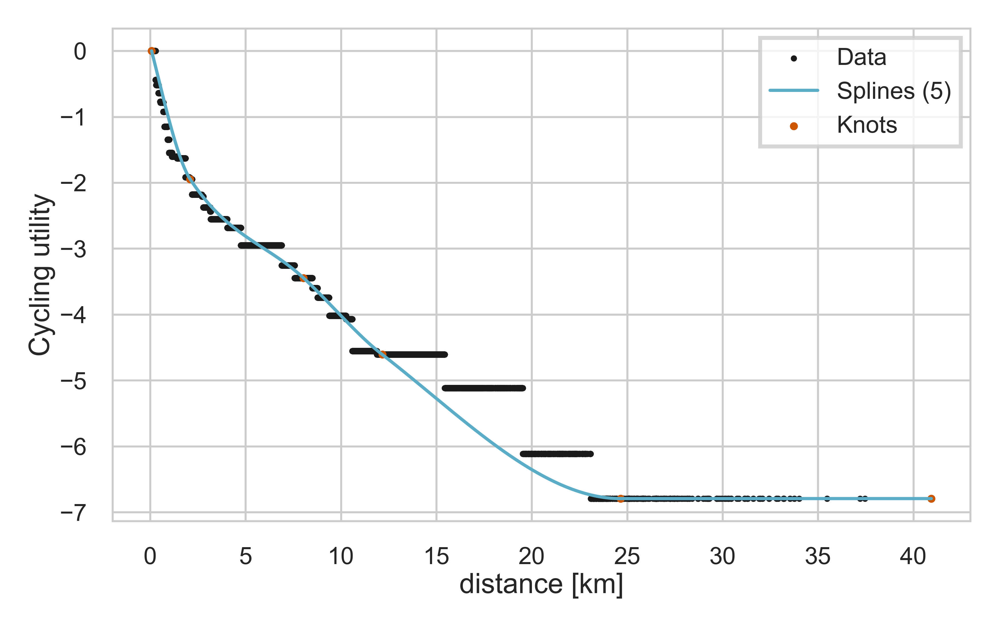

...

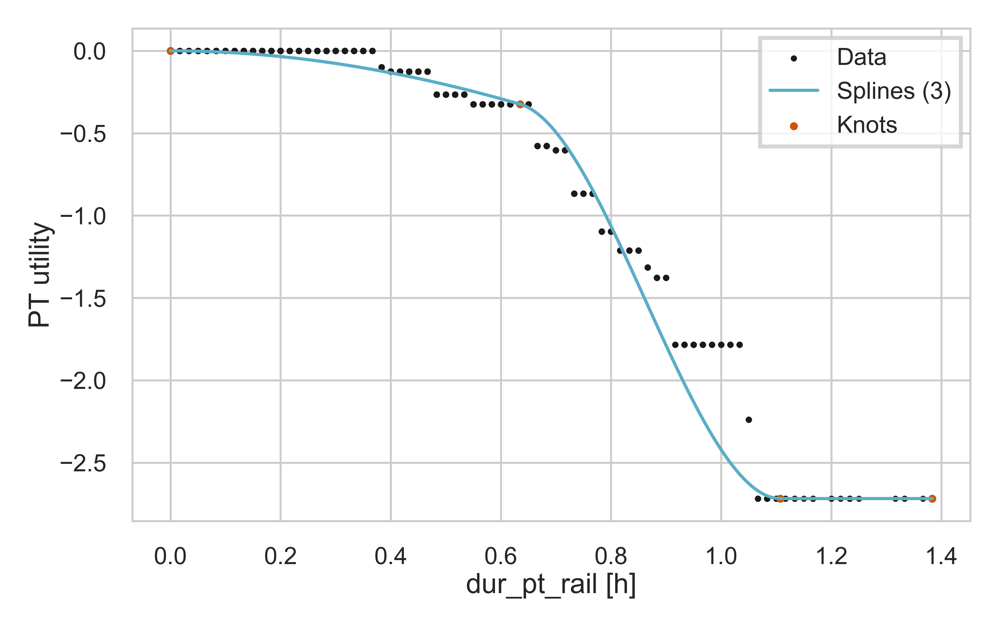

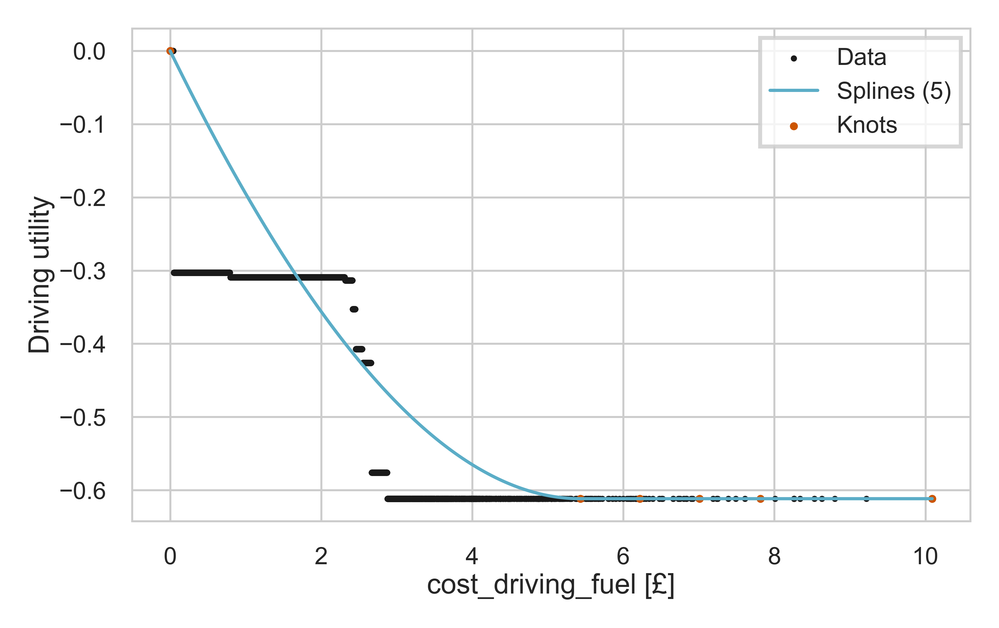

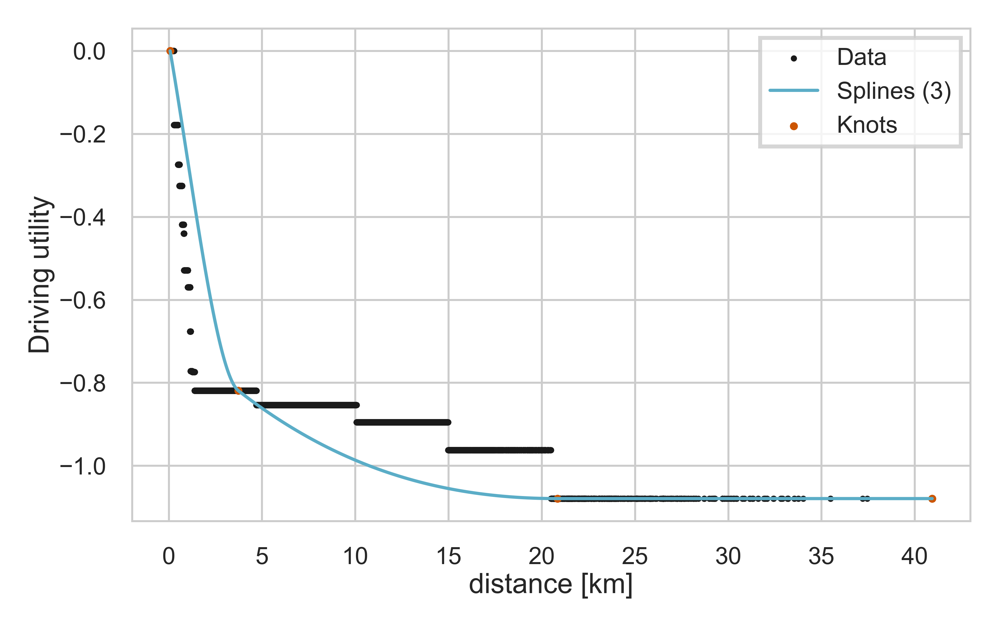

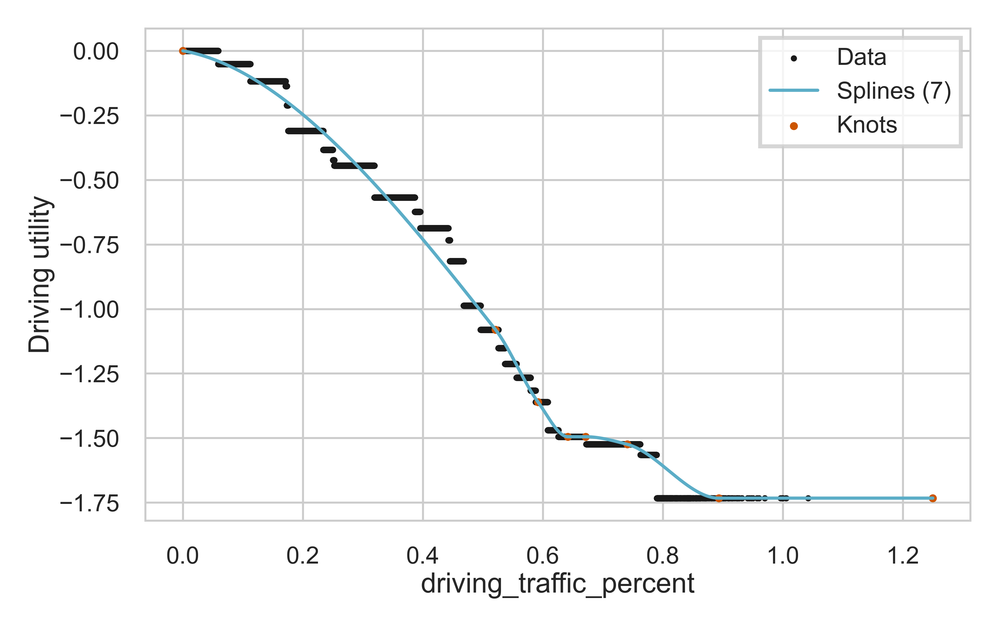

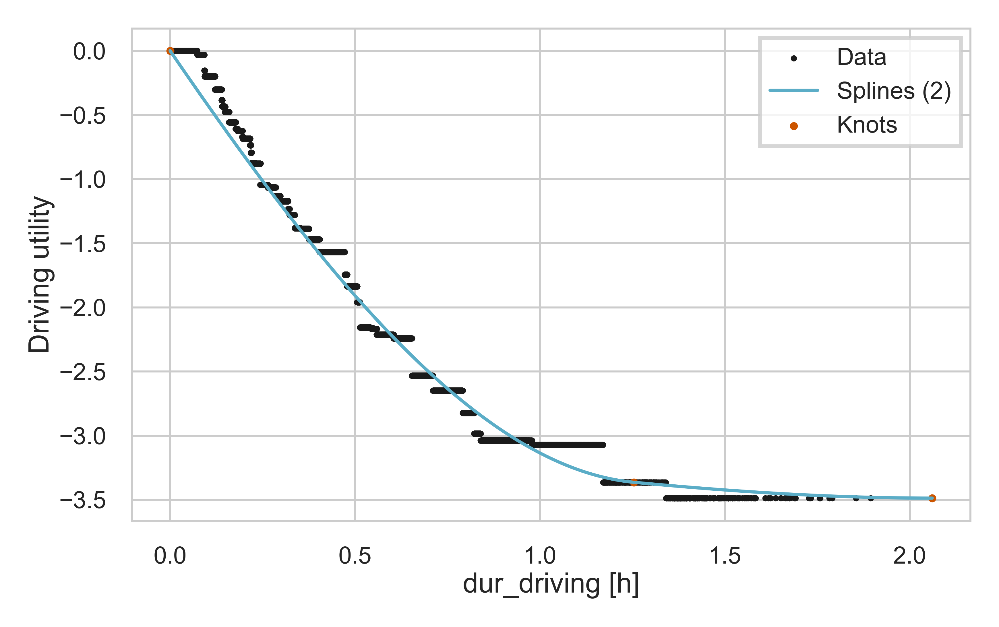

In [23]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

## Value of time

Using the smoothed utility functions, we can compute the value of time for the population, and per attributes

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:1023: UserWarning: linewidths is ignored by contourf
  #axes.set_title(f'{utility_names[u]}')


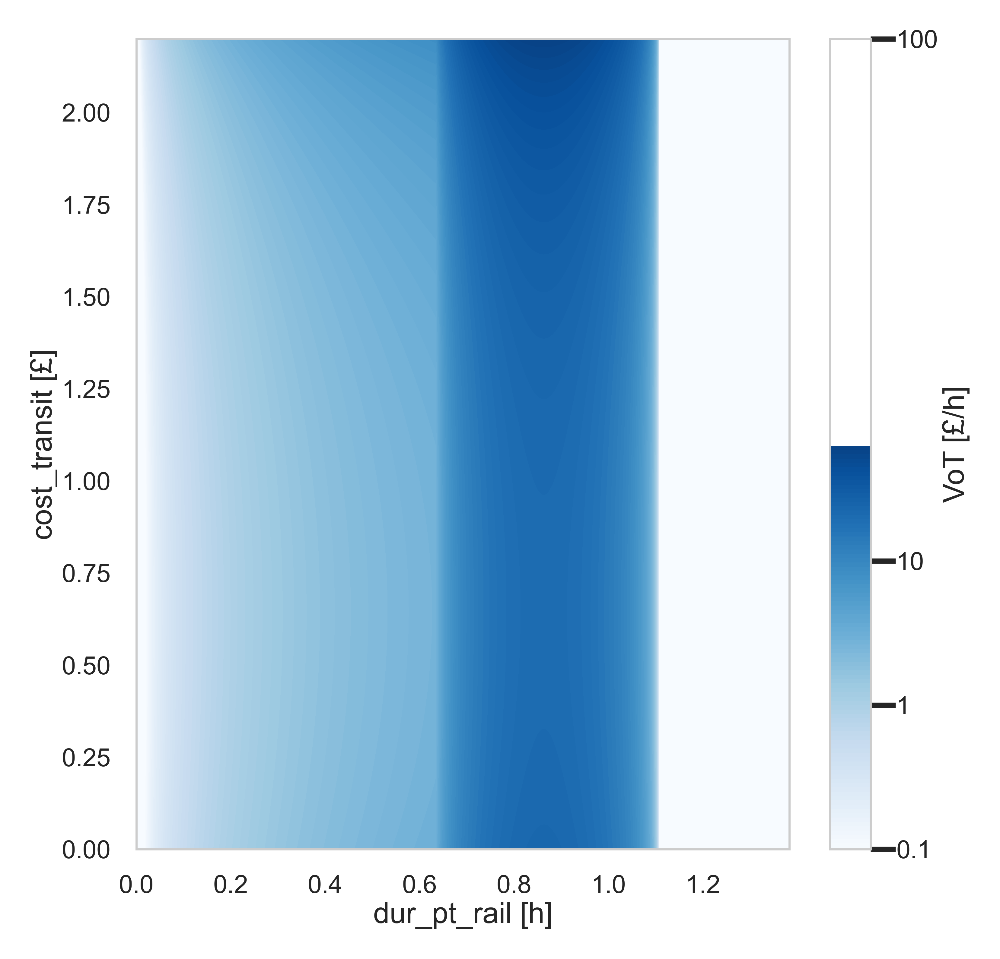

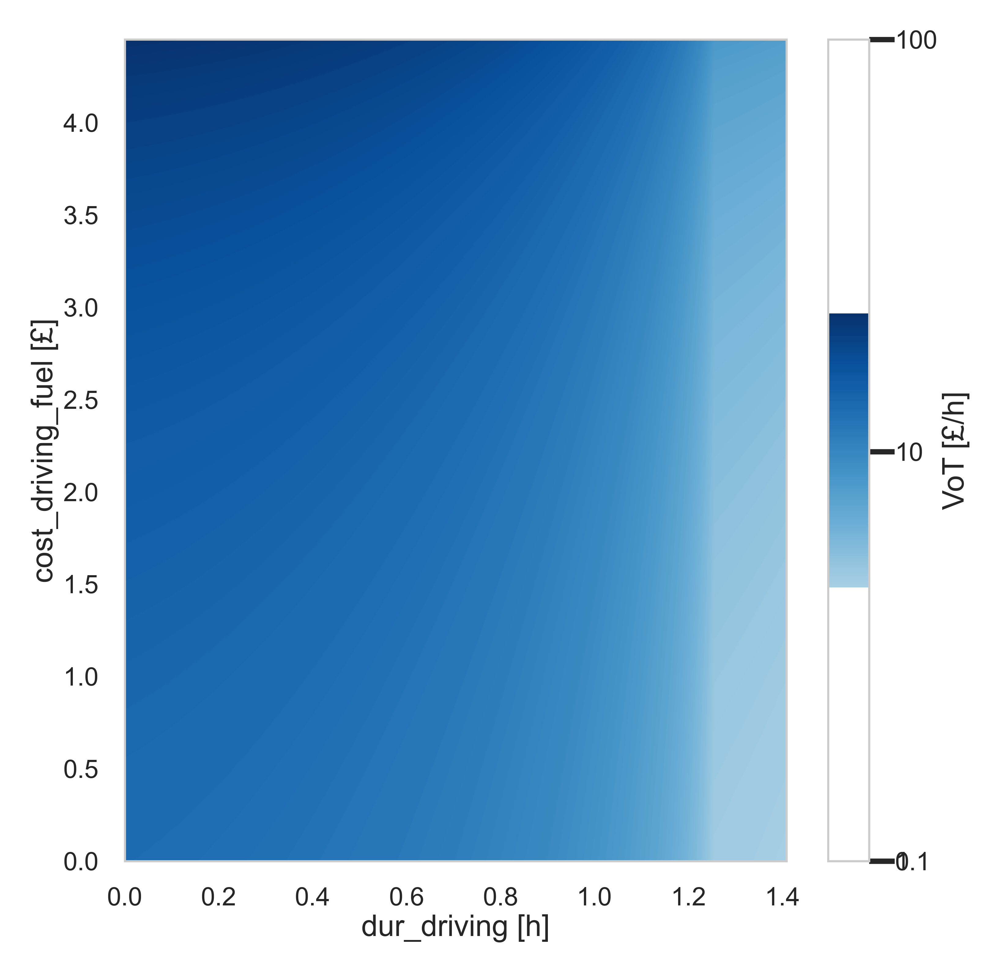

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:1081: RuntimeWarning: divide by zero encountered in divide
  limited_VoT_pop = filtered_VoT_pop[(filtered_VoT_pop>0) & (filtered_VoT_pop < np.quantile(filtered_VoT_pop, 0.99))]
c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:1081: RuntimeWarning: invalid value encountered in divide
  limited_VoT_pop = filtered_VoT_pop[(filtered_VoT_pop>0) & (filtered_VoT_pop < np.quantile(filtered_VoT_pop, 0.99))]


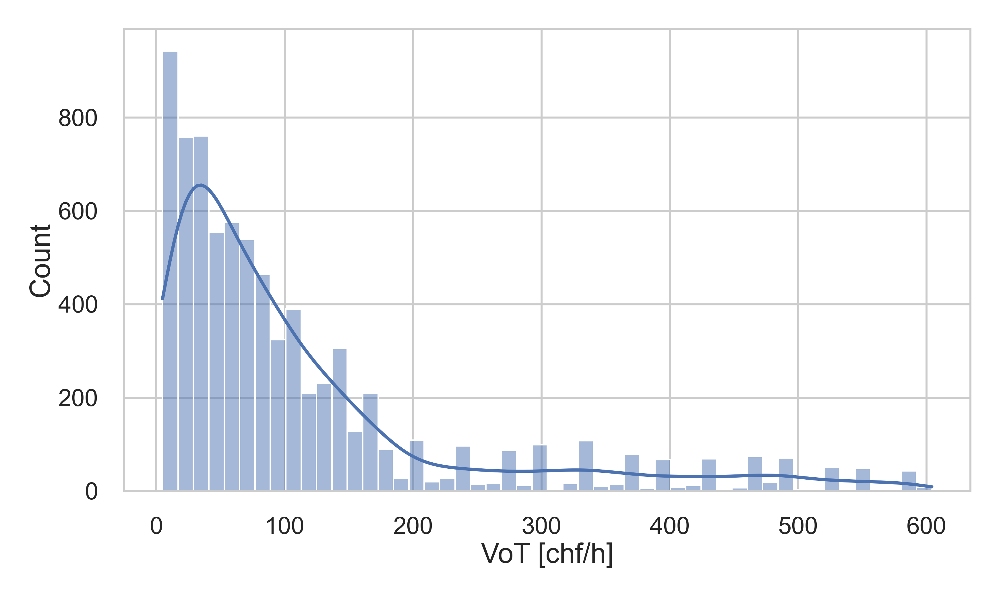

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:1081: RuntimeWarning: divide by zero encountered in divide
  limited_VoT_pop = filtered_VoT_pop[(filtered_VoT_pop>0) & (filtered_VoT_pop < np.quantile(filtered_VoT_pop, 0.99))]


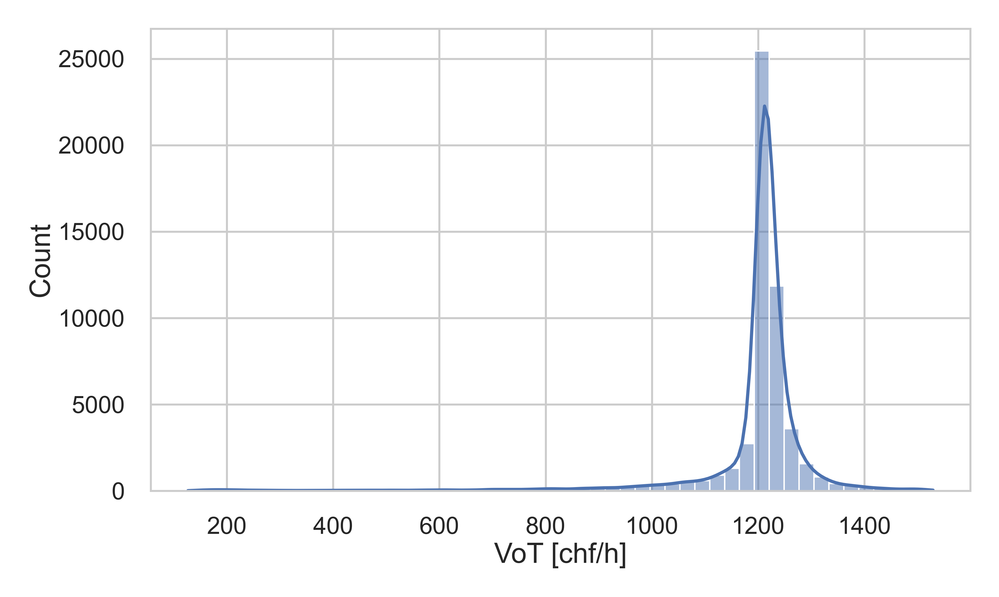

In [29]:
%load_ext autoreload
%autoreload 2

attribute_VoT =  {'2': ('dur_pt_rail', 'cost_transit'), '3':('dur_driving', 'cost_driving_fuel')}
draw_range = {'2':{'dur_pt_rail':(0,1.383), 'cost_transit':(0, 2.2)}, '3':{'dur_driving':(0, 1.409), 'cost_driving_fuel':(0, 4.45)}}

plot_VoT(LPMC_train, util_collection, attribute_VoT, utility_names={'0': 'Walking', '1': 'Cycling', '2':'Rail', '3':'Driving'}, draw_range=draw_range, save_figure=False)

plot_pop_VoT(LPMC_train, util_collection, attribute_VoT, save_figure=False)

## Model robustness

You can obtain some measure of robustness with bootstrapping and plot the figures for all variables specified.

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations
Finished loading model, total used 2000 iterations


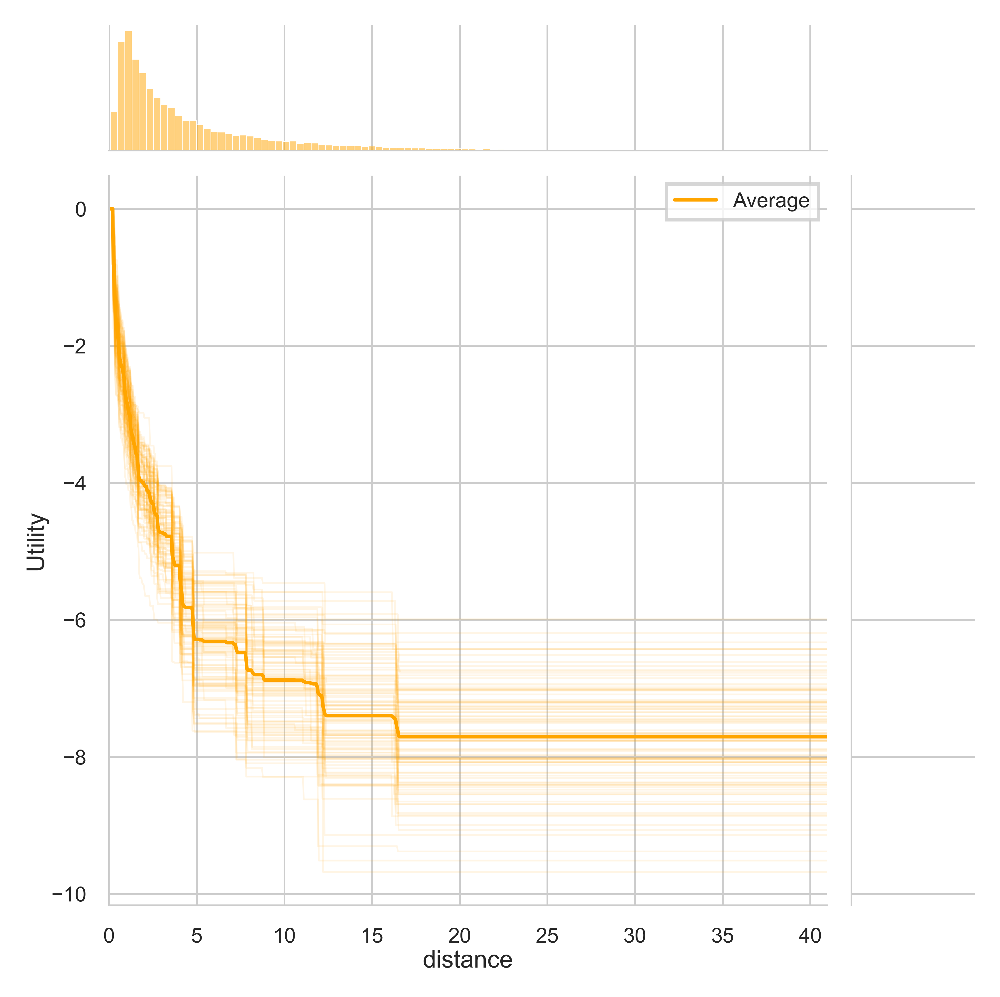

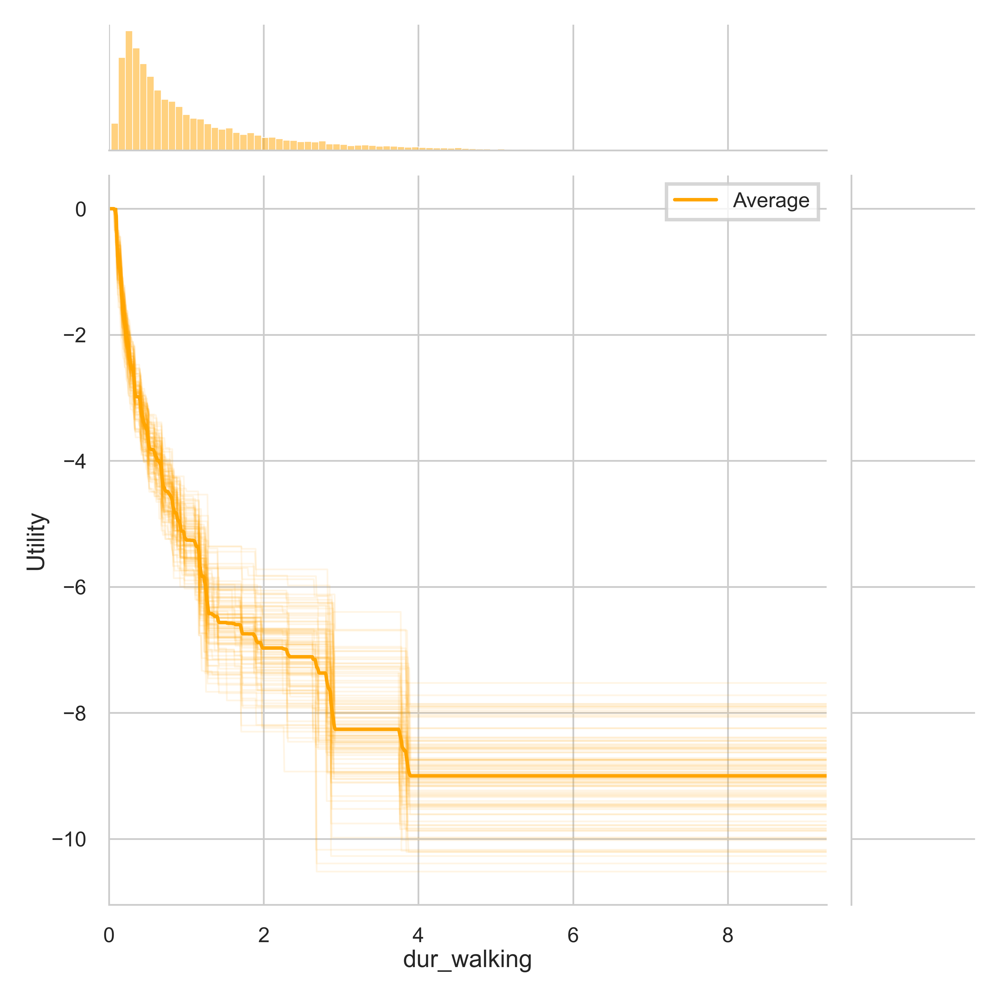

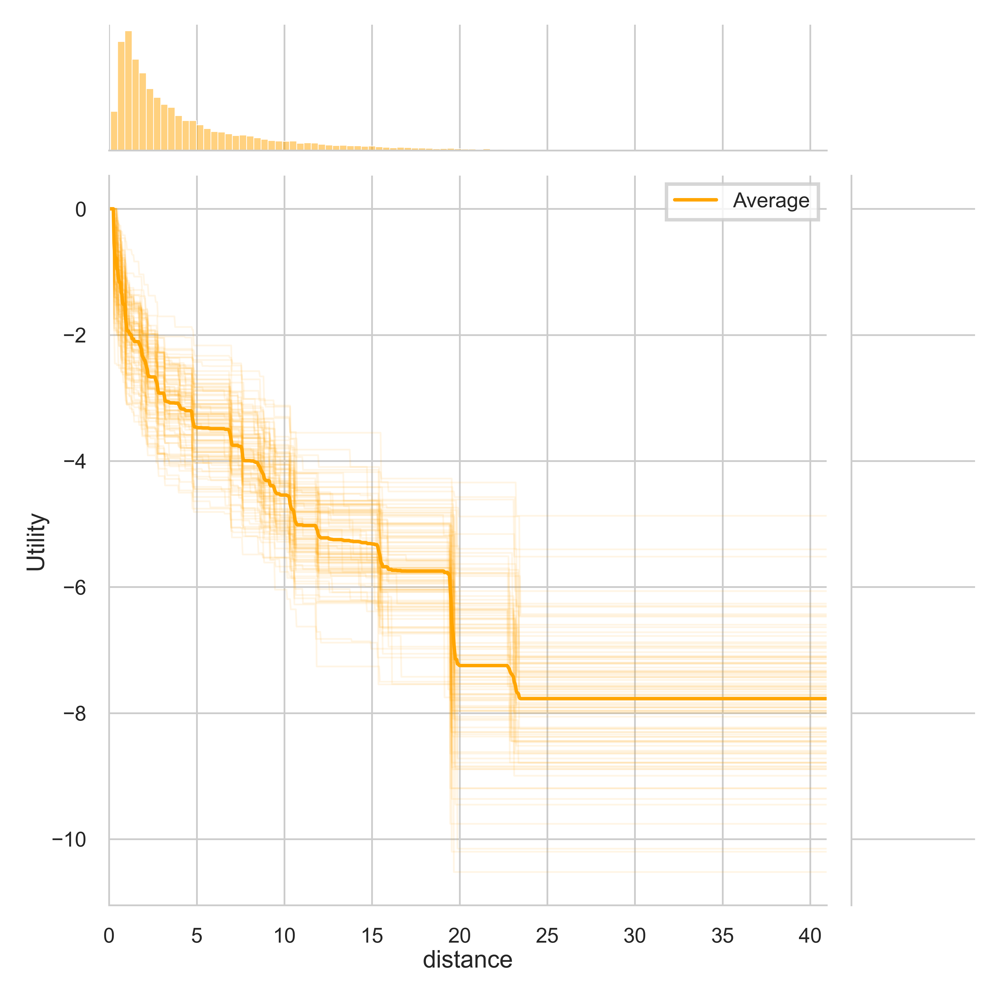

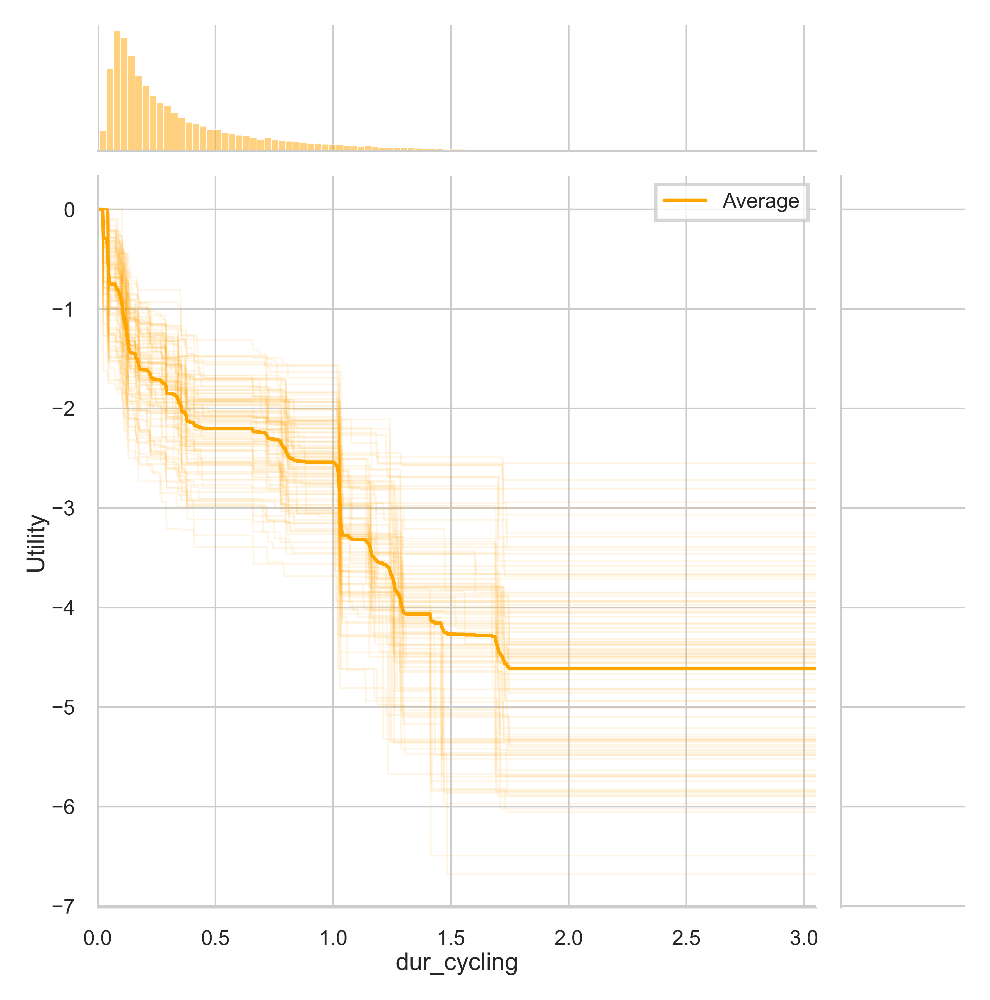

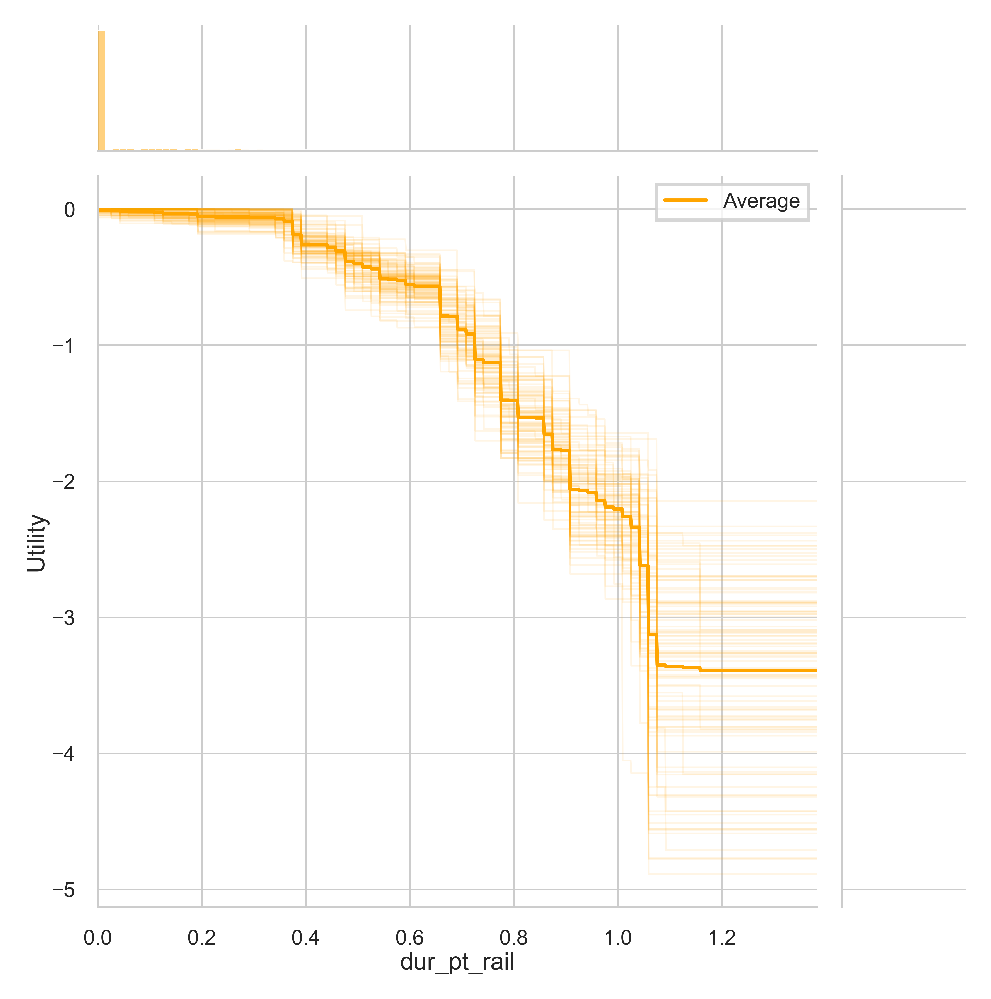

...

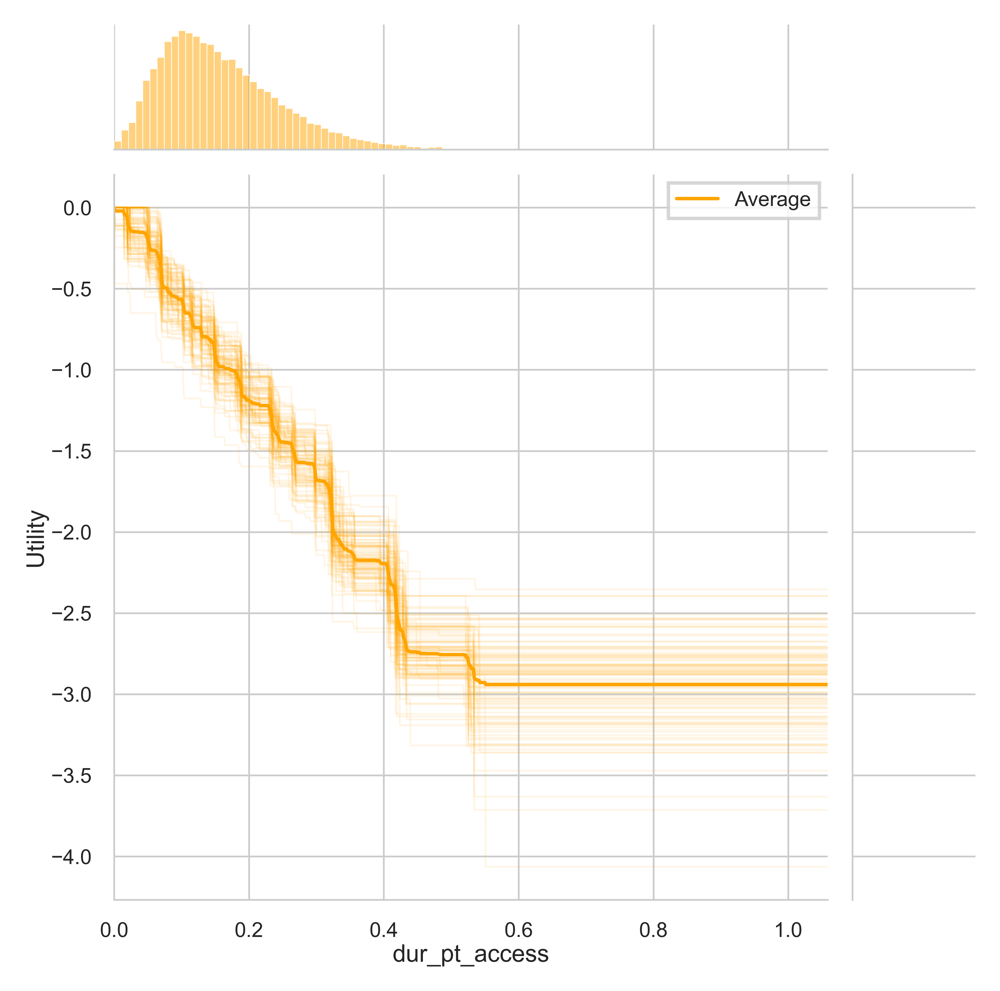

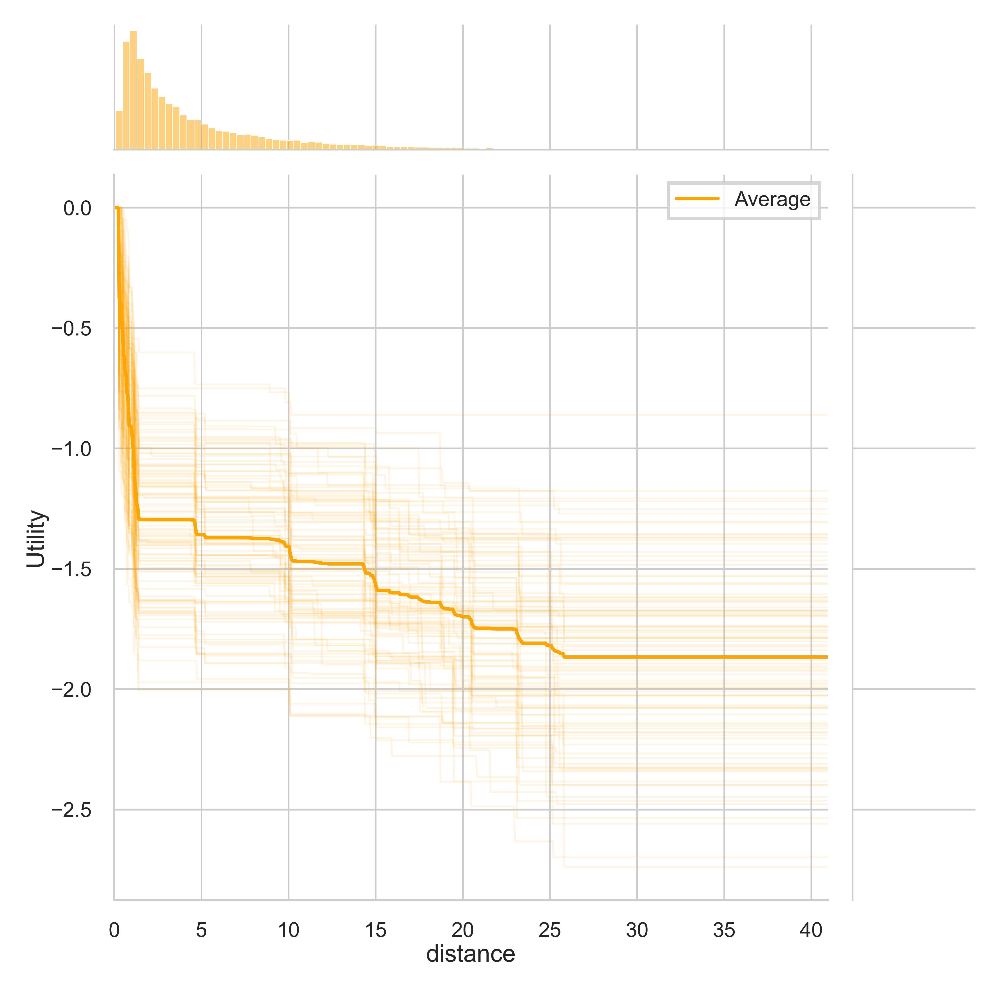

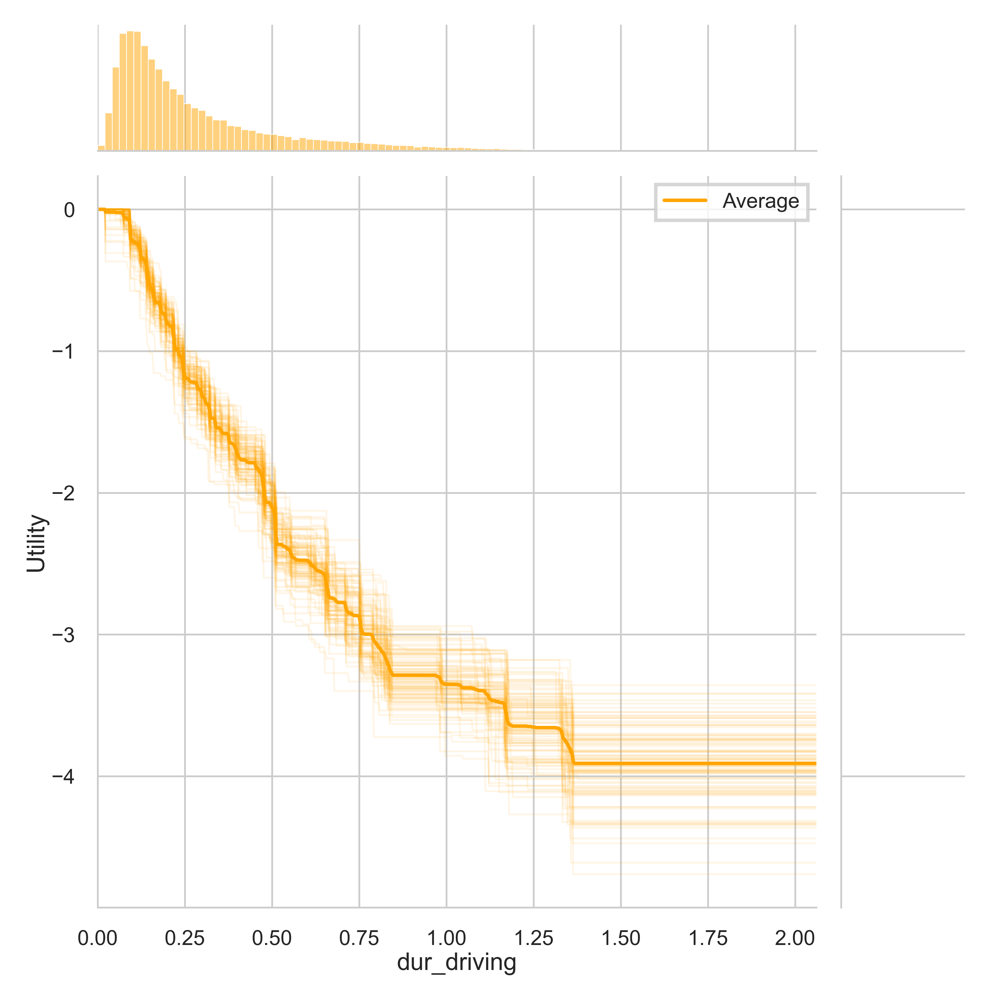

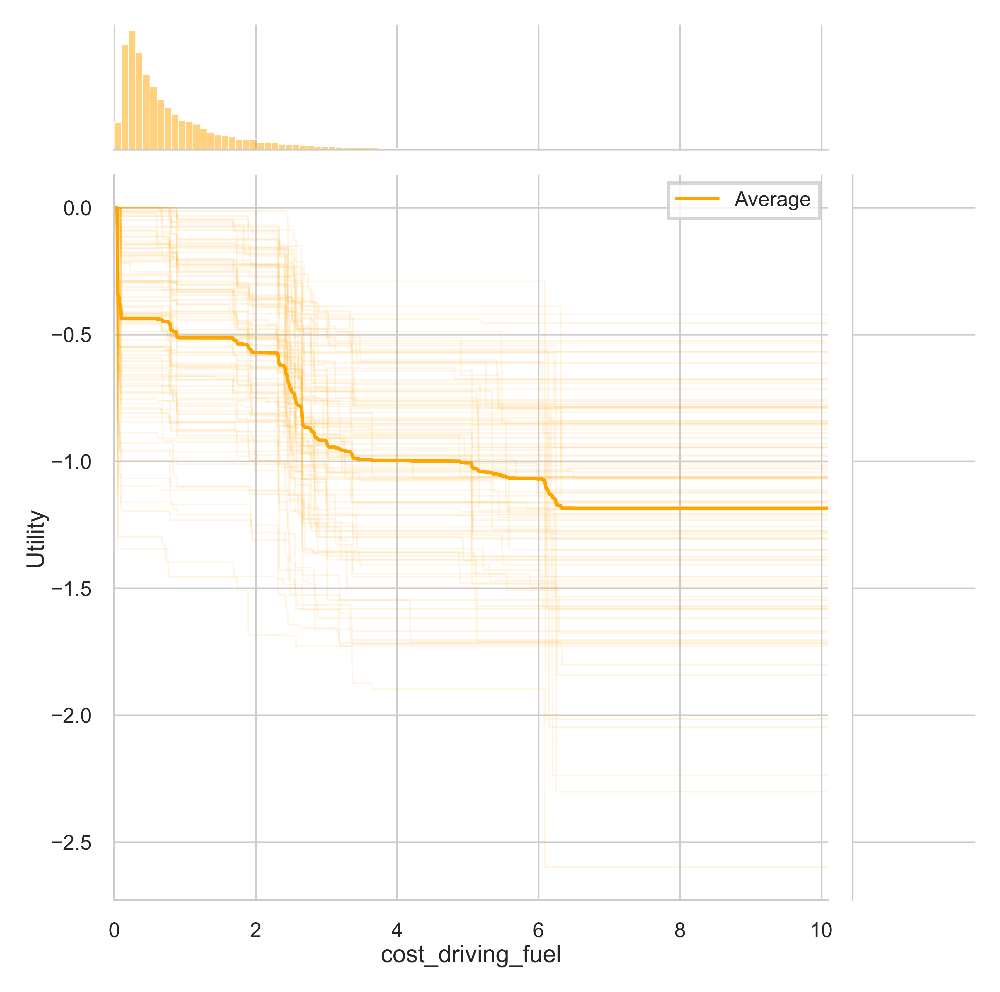

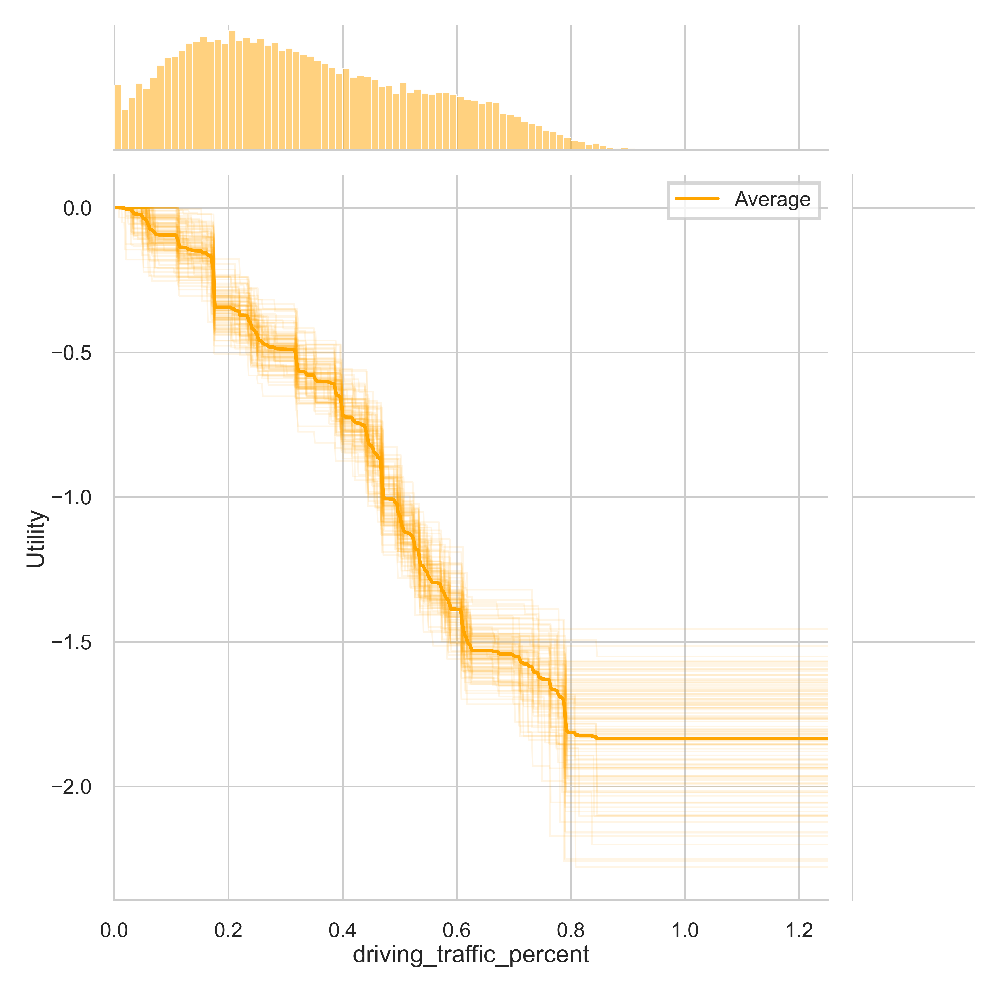

In [30]:
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':2000,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

models = bootstrap(LPMC_train, params, rum_structure)

features = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}


plot_bootstrap(models, LPMC_train, features)

## Nested probabilities

We can also relax the assumption of i.i.d on the error term. If we assume that alternatives are correlated, we obtain a nested logit-like model. Nested logit probabilities are implemented in RUMBoost, while the additional parameters, the scale of a nest $\mu$ is treated as a hyperparameter

### $\mu$ hyperparameter search

Again, for compuational purposes we don't run the full hyperparameter search, but the search for the paper was done with 25 iterations.

In [31]:
_, _, folds = load_preprocess_LPMC()

nest = {0:0, 1:1, 2:2, 3:2}
param_space =  {'mu': hyperopt.hp.uniform('mu', 1, 2)}

STATIC_PARAMS = {'n_jobs': -1,
                'num_classes':4,
                'objective':'multiclass',
                'boosting': 'gbdt',
                'monotone_constraints_method': 'advanced',
                'verbosity': -1,
                'early_stopping_round':100,
                'num_iterations': 3000,
                'learning_rate':0.1
                }

def objective(space):
    params = {**space, **STATIC_PARAMS}
    params['max_depth'] = 1
    rum_structure = bio_to_rumboost(LPMC_model)
    mu = [1, 1, params.pop("mu")]

        # Applying k-Fold Cross Validation
    loss = 0
    N_sum = 0

    for train_idx, test_idx in folds:
        # Obtain training and testing data for this iteration (split of de k-Fold)
        train_set = lgb_train_set.subset(sorted(train_idx))
        test_set = lgb_train_set.subset(sorted(test_idx))

        clf_trained = rum_train(params, train_set, rum_structure, valid_sets=[test_set], nests=nest, mu=mu)

        proba, _, _ = clf_trained.predict(test_set, nests=nest, mu=mu)

        # Cross-Entropy Loss
        sum = 0
        i = 0
        for sel_mode in test_set.get_label():
            sum = sum + np.log(proba[i,int(sel_mode)])
            i += 1
        N = i - 1
        loss += -sum  # Original: (-sum/N) * N
        N_sum += N

    loss = loss / N_sum
    return {'loss': loss, 'status': hyperopt.STATUS_OK, 'best_iteration': clf_trained.best_iteration}


#%%
n_iter = 1

trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n_iter,
                                trials=trials)

print(f'Best mu: {best_classifier["mu"]} \n Best negative CE: {trials.best_trial["result"]["loss"]}')


  0%|          | 0/1 [00:00<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic

Early stopping at iteration 1479, with a best score on test set of 0.6544299045501984, and on train set of 0.6380820713252596
Finished loading model, total used 1580 iterations   
Finished loading model, total used 1580 iterations   
Finished loading model, total used 1580 iterations   
Finished loading model, total used 1580 iterations   
  0%|          | 0/1 [01:02<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic

Early stopping at iteration 1690, with a best score on test set of 0.6410112630100522, and on train set of 0.6402486340555086
Finished loading model, total used 1791 iterations   
Finished loading model, total used 1791 iterations   
Finished loading model, total used 1791 iterations   
Finished loading model, total used 1791 iterations   
  0%|          | 0/1 [02:25<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic

Early stopping at iteration 925, with a best score on test set of 0.6578589841555562, and on train set of 0.6402083980374209
Finished loading model, total used 1026 iterations   
Finished loading model, total used 1026 iterations   
Finished loading model, total used 1026 iterations   
Finished loading model, total used 1026 iterations   
  0%|          | 0/1 [03:21<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic

Early stopping at iteration 1363, with a best score on test set of 0.6627583887458023, and on train set of 0.6363975099166235
Finished loading model, total used 1464 iterations   
Finished loading model, total used 1464 iterations   
Finished loading model, total used 1464 iterations   
Finished loading model, total used 1464 iterations   
  0%|          | 0/1 [04:47<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic

Early stopping at iteration 1150, with a best score on test set of 0.6658112829700233, and on train set of 0.6361713244980006
Finished loading model, total used 1251 iterations   
Finished loading model, total used 1251 iterations   
Finished loading model, total used 1251 iterations   
Finished loading model, total used 1251 iterations   
100%|██████████| 1/1 [06:06<00:00, 366.61s/trial, best loss: 0.6564947258766161]
Best mu: 1.4237436508636614 
 Best negative CE: 0.6564947258766161


### Cross-Validation

We use cross-validation to find the optimal number of tree. We use the optimal value of $\mu$ found with hyperparameter search.

In [32]:
_, _, folds = load_preprocess_LPMC()
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':3000,
          'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

optimal_mu = [1, 1, 1.166746773143513]

ce_loss = 0
num_trees = 0

for i, (train_idx, test_idx) in enumerate(folds):
    train_set = lgb_train_set.subset(sorted(train_idx))
    test_set = lgb_train_set.subset(sorted(test_idx))

    # Create the classifier
    param = copy.deepcopy(params)
    rum_structure = bio_to_rumboost(LPMC_model)

    print('-'*50 + '\n')
    print(f'Iteration {i+1}')
    LPMC_model_trained = rum_train(param,train_set,rum_structure=rum_structure, valid_sets = [test_set], mu=optimal_mu, nests=nest)
    ce_loss += LPMC_model_trained.best_score
    num_trees += LPMC_model_trained.best_iteration
    print('-'*50 + '\n')
    print(f'Best cross entropy loss: {LPMC_model_trained.best_score}')
    print(f'Best number of trees: {LPMC_model_trained.best_iteration}')

ce_loss = ce_loss/5
num_trees = num_trees/5
print('-'*50 + '\n')
print(f'Cross validation negative cross entropy loss: {ce_loss}')
print(f'With a number of trees on average of {num_trees}')

--------------------------------------------------

Iteration 1


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 1291, with a best score on test set of 0.6543006671161781, and on train set of 0.6387160257806288
Finished loading model, total used 1392 iterations
Finished loading model, total used 1392 iterations
Finished loading model, total used 1392 iterations
Finished loading model, total used 1392 iterations
--------------------------------------------------

Best cross entropy loss: 0.6543006671161781
Best number of trees: 1291
--------------------------------------------------

Iteration 2


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 1625, with a best score on test set of 0.6409292761468673, and on train set of 0.6403367047451071
Finished loading model, total used 1726 iterations
Finished loading model, total used 1726 iterations
Finished loading model, total used 1726 iterations
Finished loading model, total used 1726 iterations
--------------------------------------------------

Best cross entropy loss: 0.6409292761468673
Best number of trees: 1625
--------------------------------------------------

Iteration 3


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 921, with a best score on test set of 0.6577617492916592, and on train set of 0.6402262085982907
Finished loading model, total used 1022 iterations
Finished loading model, total used 1022 iterations
Finished loading model, total used 1022 iterations
Finished loading model, total used 1022 iterations
--------------------------------------------------

Best cross entropy loss: 0.6577617492916592
Best number of trees: 921
--------------------------------------------------

Iteration 4


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 1232, with a best score on test set of 0.6624246467658123, and on train set of 0.636870502526712
Finished loading model, total used 1333 iterations
Finished loading model, total used 1333 iterations
Finished loading model, total used 1333 iterations
Finished loading model, total used 1333 iterations
--------------------------------------------------

Best cross entropy loss: 0.6624246467658123
Best number of trees: 1232
--------------------------------------------------

Iteration 5


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 1148, with a best score on test set of 0.6653590794887231, and on train set of 0.6362457959363418
Finished loading model, total used 1249 iterations
Finished loading model, total used 1249 iterations
Finished loading model, total used 1249 iterations
Finished loading model, total used 1249 iterations
--------------------------------------------------

Best cross entropy loss: 0.6653590794887231
Best number of trees: 1148
--------------------------------------------------

Cross validation negative cross entropy loss: 0.656155083761848
With a number of trees on average of 1243.4


## Testing

And we finally test the results on holdout data

In [34]:
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':1243,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

LPMCnested_model_fully_trained = rum_train(params, lgb_train_set, rum_structure, mu=optimal_mu, nests=nest)

preds, _, _ = LPMCnested_model_fully_trained.predict(lgb_test_set, mu=optimal_mu, nests=nest)

ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Finished loading model, total used 1243 iterations
Finished loading model, total used 1243 iterations
Finished loading model, total used 1243 iterations
Finished loading model, total used 1243 iterations
--------------------------------------------------
Final negative cross-entropy on the test set: 0.6732825945666746


## Functional effect model

We also present the functional effect model, inspired from the Mixed Effect models. We create two ensembles where one contains the attributes with no interaction, and another one contains the socio-economic characteristics, with no interaction restrictions.

### Hyperparameter search

We won't run the full hyperparameter search, but we did run this code for the paper.

In [35]:
_, _, folds = load_preprocess_LPMC()

param_space =  {'learning_rate': hyperopt.hp.choice('learning_rate', [0.1]),
                'num_leaves': hyperopt.pyll.scope.int(hyperopt.hp.quniform('num_leaves', 2, 100, 1)),
                'min_gain_to_split':  hyperopt.hp.loguniform('min_gain_to_split', -9.21, 1.61), # interval: [0.0001, 5]
                'min_sum_hessian_in_leaf': hyperopt.hp.loguniform('min_sum_hessian_in_leaf', 0, 4.6),
                'min_data_in_leaf': hyperopt.pyll.scope.int(hyperopt.hp.quniform('min_data_in_leaf', 1, 200, 1)),
                'bagging_fraction': hyperopt.hp.uniform('bagging_fraction', 0.5, 1),
                'bagging_freq': hyperopt.hp.choice('bagging_freq', [0, 1, 5, 10]),
                'feature_fraction': hyperopt.hp.uniform('feature_fraction', 0.5, 1),
                'lambda_l1': hyperopt.hp.loguniform('lambda_l1', -9.21, 2.30), # interval: [0.0001, 10]
                'lambda_l2': hyperopt.hp.loguniform('lambda_l2', -9.21, 2.30), # interval: [0.0001, 10]
                'max_bin': hyperopt.pyll.scope.int(hyperopt.hp.quniform('max_bin', 100, 500, 1))
                            }

STATIC_PARAMS = {'n_jobs': -1,
                'num_classes':4,
                'objective':'multiclass',
                'boosting': 'gbdt',
                'monotone_constraints_method': 'advanced',
                'verbosity': -1,
                'early_stopping_round':100,
                'num_iterations': 3000
                }

fct_effect_variables = ['age', 'female', 'start_time_linear', 'travel_day', 'day_of_week', 'car_ownership', 'driving_license', 'purpose_B', 'purpose_HBE', 'purpose_HBO', 'purpose_HBW', 'purpose_NHBO', 'fueltype_Average', 'fueltype_Diesel', 'fueltype_Hybrid', 'fueltype_Petrol']


def objective(space):
    rum_structure = bio_to_rumboost(LPMC_model, fct_effect_variables=fct_effect_variables)
    params = {'verbosity': -1,
    'num_classes':4,
    'early_stopping_round':100,
    'learning_rate': space['learning_rate'],
    'max_depth': 1,
    #'num_leaves':31,
    'num_boost_round': 3000,
    'objective':'multiclass',
    'boosting': 'gbdt',
    'monotone_constraints_method': 'advanced'}
    params_fe = {**space, **STATIC_PARAMS}

        # Applying k-Fold Cross Validation
    loss = 0
    N_sum = 0

    for train_idx, test_idx in folds:
        # Obtain training and testing data for this iteration (split of de k-Fold)
        train_set = lgb_train_set.subset(sorted(train_idx))
        test_set = lgb_train_set.subset(sorted(test_idx))

        clf_trained = rum_train(params, train_set, rum_structure, valid_sets=[test_set], params_fe=params_fe)

        proba = clf_trained.predict(test_set)

        # Cross-Entropy Loss
        sum = 0
        i = 0
        for sel_mode in test_set.get_label():
            sum = sum + np.log(proba[i,int(sel_mode)])
            i += 1
        N = i - 1
        loss += -sum  # Original: (-sum/N) * N
        N_sum += N

    loss = loss / N_sum
    return {'loss': loss, 'status': hyperopt.STATUS_OK, 'best_iteration': clf_trained.best_iteration}


#%%
#n_iter = 100
n_iter = 1
# Read a previous adjusted-hyperparameters datafile or create a new one

trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n_iter,
                                trials=trials)

print(f'Best negative CE: {trials.best_trial["result"]["loss"]}')


  0%|          | 0/1 [00:00<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basi

Early stopping at iteration 1251, with a best score on test set of 0.6454486526957377, and on train set of 0.6042533670346607
Finished loading model, total used 1352 iterations   
Finished loading model, total used 141 iterations    
Finished loading model, total used 1352 iterations   
Finished loading model, total used 136 iterations    
Finished loading model, total used 1352 iterations   
Finished loading model, total used 167 iterations    
Finished loading model, total used 1352 iterations   
Finished loading model, total used 177 iterations    
  0%|          | 0/1 [00:16<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basi

Early stopping at iteration 893, with a best score on test set of 0.6302918556697563, and on train set of 0.6096794185154071
Finished loading model, total used 994 iterations    
Finished loading model, total used 147 iterations    
Finished loading model, total used 994 iterations    
Finished loading model, total used 79 iterations     
Finished loading model, total used 994 iterations    
Finished loading model, total used 149 iterations    
Finished loading model, total used 994 iterations    
Finished loading model, total used 169 iterations    
  0%|          | 0/1 [00:28<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basi

Early stopping at iteration 811, with a best score on test set of 0.6499427595124949, and on train set of 0.6020655160103751
Finished loading model, total used 912 iterations    
Finished loading model, total used 176 iterations    
Finished loading model, total used 912 iterations    
Finished loading model, total used 114 iterations    
Finished loading model, total used 912 iterations    
Finished loading model, total used 168 iterations    
Finished loading model, total used 912 iterations    
Finished loading model, total used 172 iterations    
  0%|          | 0/1 [00:39<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basi

Early stopping at iteration 972, with a best score on test set of 0.6490321117110754, and on train set of 0.6022752400947645
Finished loading model, total used 1073 iterations   
Finished loading model, total used 159 iterations    
Finished loading model, total used 1073 iterations   
Finished loading model, total used 103 iterations    
Finished loading model, total used 1073 iterations   
Finished loading model, total used 166 iterations    
Finished loading model, total used 1073 iterations   
Finished loading model, total used 225 iterations    
  0%|          | 0/1 [00:52<?, ?trial/s, best loss=?]

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')

c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basi

Early stopping at iteration 806, with a best score on test set of 0.6515539389129131, and on train set of 0.6028902823256596
Finished loading model, total used 907 iterations    
Finished loading model, total used 148 iterations    
Finished loading model, total used 907 iterations    
Finished loading model, total used 92 iterations     
Finished loading model, total used 907 iterations    
Finished loading model, total used 179 iterations    
Finished loading model, total used 907 iterations    
Finished loading model, total used 197 iterations    
100%|██████████| 1/1 [01:03<00:00, 63.35s/trial, best loss: 0.645342817333636]
Best negative CE: 0.645342817333636


### Cross-validation with already computed optimal hyperparameters

In [36]:
_, _, folds = load_preprocess_LPMC()
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':3000,
          'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

optimal_params_fe = {'learning_rate':0.1,
                'num_leaves': 74,
                'min_gain_to_split': 0.8003177141507178,
                'min_sum_hessian_in_leaf': 1.7832435538908582,
                'min_data_in_leaf': 27,
                'bagging_fraction': 0.7002428082063967,
                'bagging_freq': 10,
                'feature_fraction': 0.8666540515437967,
                'lambda_l1': 6.591757385667399,
                'lambda_l2': 1.027567442472481,
                'max_bin': 131
                            }

ce_loss = 0
num_trees = 0

for i, (train_idx, test_idx) in enumerate(folds):
    train_set = lgb_train_set.subset(sorted(train_idx))
    test_set = lgb_train_set.subset(sorted(test_idx))

    # Create the classifier
    param = copy.deepcopy(params)
    rum_structure = bio_to_rumboost(LPMC_model, fct_effect_variables=fct_effect_variables) # specify variables in the functional effect model

    print('-'*50 + '\n')
    print(f'Iteration {i+1}')
    LPMC_model_trained = rum_train(param,train_set,rum_structure=rum_structure, valid_sets = [test_set], params_fe=optimal_params_fe)
    ce_loss += LPMC_model_trained.best_score
    num_trees += LPMC_model_trained.best_iteration
    print('-'*50 + '\n')
    print(f'Best cross entropy loss: {LPMC_model_trained.best_score}')
    print(f'Best number of trees: {LPMC_model_trained.best_iteration}')

ce_loss = ce_loss/5
num_trees = num_trees/5
print('-'*50 + '\n')
print(f'Cross validation negative cross entropy loss: {ce_loss}')
print(f'With a number of trees on average of {num_trees}')

--------------------------------------------------

Iteration 1


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 926, with a best score on test set of 0.6446090721289347, and on train set of 0.6068617625947127
Finished loading model, total used 1027 iterations
Finished loading model, total used 155 iterations
Finished loading model, total used 1027 iterations
Finished loading model, total used 106 iterations
Finished loading model, total used 1027 iterations
Finished loading model, total used 243 iterations
Finished loading model, total used 1027 iterations
Finished loading model, total used 222 iterations
--------------------------------------------------

Best cross entropy loss: 0.6446090721289347
Best number of trees: 926
--------------------------------------------------

Iteration 2


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 854, with a best score on test set of 0.6255357296736198, and on train set of 0.6111764925779694
Finished loading model, total used 955 iterations
Finished loading model, total used 164 iterations
Finished loading model, total used 955 iterations
Finished loading model, total used 89 iterations
Finished loading model, total used 955 iterations
Finished loading model, total used 258 iterations
Finished loading model, total used 955 iterations
Finished loading model, total used 182 iterations
--------------------------------------------------

Best cross entropy loss: 0.6255357296736198
Best number of trees: 854
--------------------------------------------------

Iteration 3


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 771, with a best score on test set of 0.6477513809305059, and on train set of 0.6043210880579042
Finished loading model, total used 872 iterations
Finished loading model, total used 199 iterations
Finished loading model, total used 872 iterations
Finished loading model, total used 107 iterations
Finished loading model, total used 872 iterations
Finished loading model, total used 229 iterations
Finished loading model, total used 872 iterations
Finished loading model, total used 179 iterations
--------------------------------------------------

Best cross entropy loss: 0.6477513809305059
Best number of trees: 771
--------------------------------------------------

Iteration 4


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 1774, with a best score on test set of 0.6463650094840885, and on train set of 0.6032431086985517
Finished loading model, total used 1875 iterations
Finished loading model, total used 207 iterations
Finished loading model, total used 1875 iterations
Finished loading model, total used 139 iterations
Finished loading model, total used 1875 iterations
Finished loading model, total used 218 iterations
Finished loading model, total used 1875 iterations
Finished loading model, total used 252 iterations
--------------------------------------------------

Best cross entropy loss: 0.6463650094840885
Best number of trees: 1774
--------------------------------------------------

Iteration 5


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 558, with a best score on test set of 0.6490161142689254, and on train set of 0.6070754687880728
Finished loading model, total used 659 iterations
Finished loading model, total used 194 iterations
Finished loading model, total used 659 iterations
Finished loading model, total used 97 iterations
Finished loading model, total used 659 iterations
Finished loading model, total used 231 iterations
Finished loading model, total used 659 iterations
Finished loading model, total used 193 iterations
--------------------------------------------------

Best cross entropy loss: 0.6490161142689254
Best number of trees: 558
--------------------------------------------------

Cross validation negative cross entropy loss: 0.6426554612972148
With a number of trees on average of 976.6


## Testing on holdout data

In [37]:
rum_structure = bio_to_rumboost(LPMC_model, fct_effect_variables=fct_effect_variables)
params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':977,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

LPMCFE_model_fully_trained = rum_train(params, lgb_train_set, rum_structure, params_fe=optimal_params_fe)

preds = LPMCFE_model_fully_trained.predict(lgb_test_set)

ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Finished loading model, total used 977 iterations
Finished loading model, total used 133 iterations
Finished loading model, total used 977 iterations
Finished loading model, total used 86 iterations
Finished loading model, total used 977 iterations
Finished loading model, total used 288 iterations
Finished loading model, total used 977 iterations
Finished loading model, total used 308 iterations
--------------------------------------------------
Final negative cross-entropy on the test set: 0.6620119239324455


### Separation of the two models, and individual-specific constant

We can retrieve the two part of the model and plot the individual-specific constant resulting of the full interaction of the socio-economic characteristics. The attribute part can be used to plot the attribute utility just like in a classic RUMBoost model, and can be smoothed and lead to VoT.

In [38]:
attributes_model, socec_model = split_fe_model(LPMCFE_model_fully_trained)

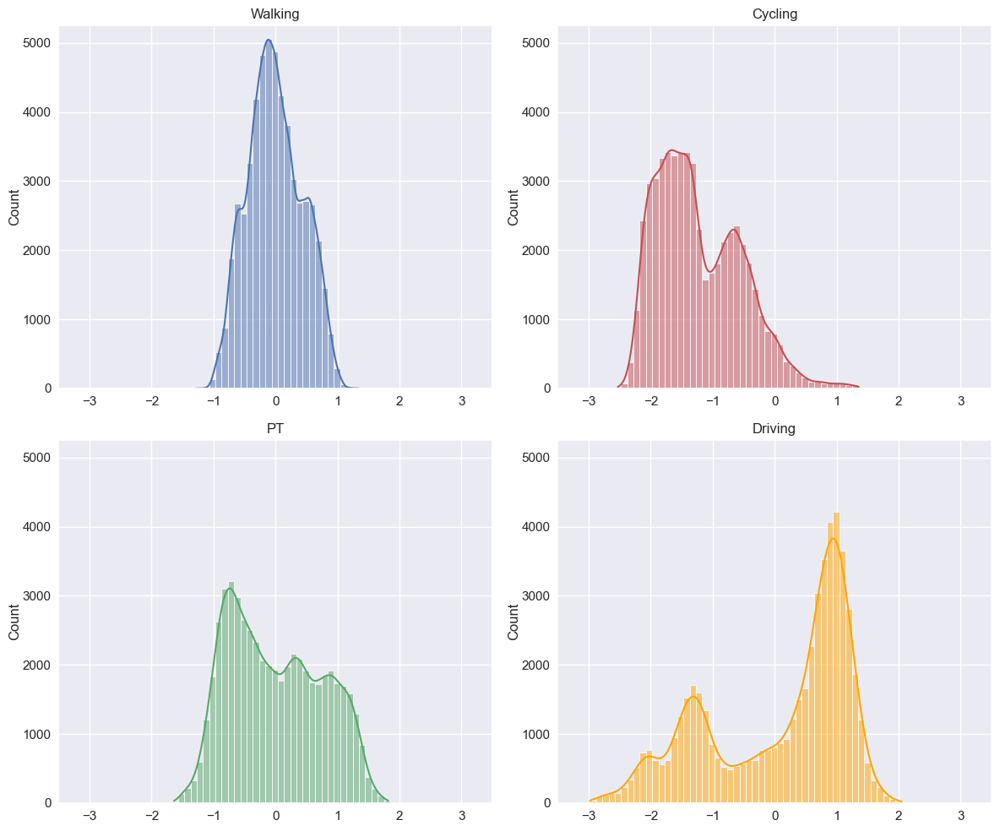

In [40]:
plot_ind_spec_constant(socec_model, lgb_train_set, ['Walking', 'Cycling', 'PT', 'Driving'])

## Attribute interactions model

We arbitrarily allow for the age and the travel time to interact. To do so, we update the attribute interaction part of the model in the rum_structure dictionary. We keep the same hyperparameters from rumboost, apart from the number of boosting rounds.

### Training with 5-fold CV

In [41]:
_, _, folds = load_preprocess_LPMC()

params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':3000,
          'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

ce_loss = 0
num_trees = 0

for i, (train_idx, test_idx) in enumerate(folds):
    train_set = lgb_train_set.subset(sorted(train_idx))
    test_set = lgb_train_set.subset(sorted(test_idx))

    # Create the classifier
    params['max_depth'] = 2
    param = copy.deepcopy(params)
    rum_structure = bio_to_rumboost(LPMC_model)
    rum_structure[0]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14]]
    rum_structure[1]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14]]
    rum_structure[2]['interaction_constraints'] = [[0, 17], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14], [16], [18], [19], [20], [21], [22]]
    rum_structure[3]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14], [17]]

    print('-'*50 + '\n')
    print(f'Iteration {i+1}')
    LPMC_model_trained = rum_train(param,train_set,rum_structure=rum_structure, valid_sets = [test_set])
    ce_loss += LPMC_model_trained.best_score
    num_trees += LPMC_model_trained.best_iteration
    print('-'*50 + '\n')
    print(f'Best cross entropy loss: {LPMC_model_trained.best_score}')
    print(f'Best number of trees: {LPMC_model_trained.best_iteration}')

ce_loss = ce_loss/5
num_trees = num_trees/5
print('-'*50 + '\n')
print(f'Cross validation negative cross entropy loss: {ce_loss}')
print(f'With a number of trees on average of {num_trees}')

--------------------------------------------------

Iteration 1


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 767, with a best score on test set of 0.6661164209958064, and on train set of 0.6420175972170987
Finished loading model, total used 868 iterations
Finished loading model, total used 868 iterations
Finished loading model, total used 868 iterations
Finished loading model, total used 868 iterations
--------------------------------------------------

Best cross entropy loss: 0.6661164209958064
Best number of trees: 767
--------------------------------------------------

Iteration 2


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 683, with a best score on test set of 0.6537943544223168, and on train set of 0.6462670257070037
Finished loading model, total used 784 iterations
Finished loading model, total used 784 iterations
Finished loading model, total used 784 iterations
Finished loading model, total used 784 iterations
--------------------------------------------------

Best cross entropy loss: 0.6537943544223168
Best number of trees: 683
--------------------------------------------------

Iteration 3


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 755, with a best score on test set of 0.665407782702733, and on train set of 0.6424541437034261
Finished loading model, total used 856 iterations
Finished loading model, total used 856 iterations
Finished loading model, total used 856 iterations
Finished loading model, total used 856 iterations
--------------------------------------------------

Best cross entropy loss: 0.665407782702733
Best number of trees: 755
--------------------------------------------------

Iteration 4


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 659, with a best score on test set of 0.6715070781285492, and on train set of 0.6424287371558288
Finished loading model, total used 760 iterations
Finished loading model, total used 760 iterations
Finished loading model, total used 760 iterations
Finished loading model, total used 760 iterations
--------------------------------------------------

Best cross entropy loss: 0.6715070781285492
Best number of trees: 659
--------------------------------------------------

Iteration 5


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Early stopping at iteration 572, with a best score on test set of 0.678648991376894, and on train set of 0.6425330439072285
Finished loading model, total used 673 iterations
Finished loading model, total used 673 iterations
Finished loading model, total used 673 iterations
Finished loading model, total used 673 iterations
--------------------------------------------------

Best cross entropy loss: 0.678648991376894
Best number of trees: 572
--------------------------------------------------

Cross validation negative cross entropy loss: 0.6670949255252598
With a number of trees on average of 687.2


### Testing on holdout data

In [42]:
rum_structure = bio_to_rumboost(LPMC_model)
rum_structure[0]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14]]
rum_structure[1]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14]]
rum_structure[2]['interaction_constraints'] = [[0, 17], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14], [16], [18], [19], [20], [21], [22]]
rum_structure[3]['interaction_constraints'] = [[0, 16], [2], [5], [15], [1], [3], [4], [6], [7], [8], [9], [10], [11], [12], [13], [14], [17]]

params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':687,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':2
          }

LPMCFI_model_fully_trained = rum_train(params, lgb_train_set, rum_structure)

preds = LPMCFI_model_fully_trained.predict(lgb_test_set)

ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------
Final negative cross-entropy on the test set: 0.6853732131802694


### Plotting feature interaction on a contour plot

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:110: UserWarning: linewidths is ignored by contourf
  c_plot = axes.contourf(X, Y, contour_plot.T, levels=res, linewidths=0, cmap=customPalette, vmin=-12, vmax=0)


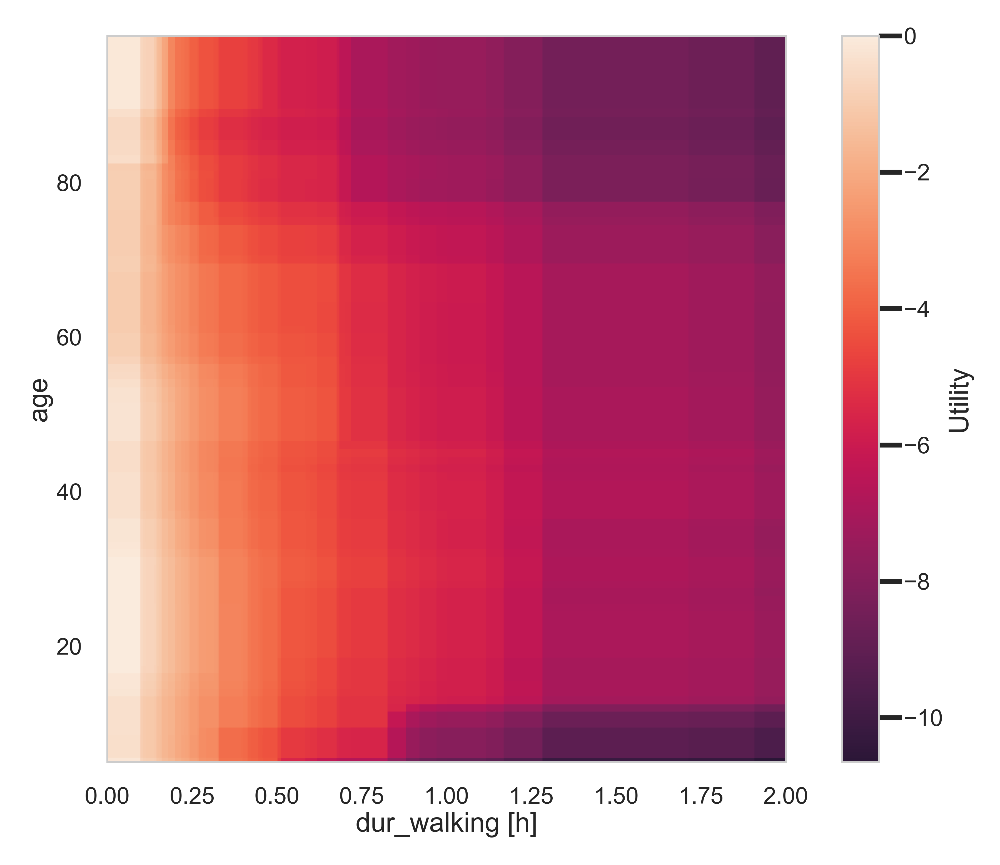

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:110: UserWarning: linewidths is ignored by contourf
  c_plot = axes.contourf(X, Y, contour_plot.T, levels=res, linewidths=0, cmap=customPalette, vmin=-12, vmax=0)


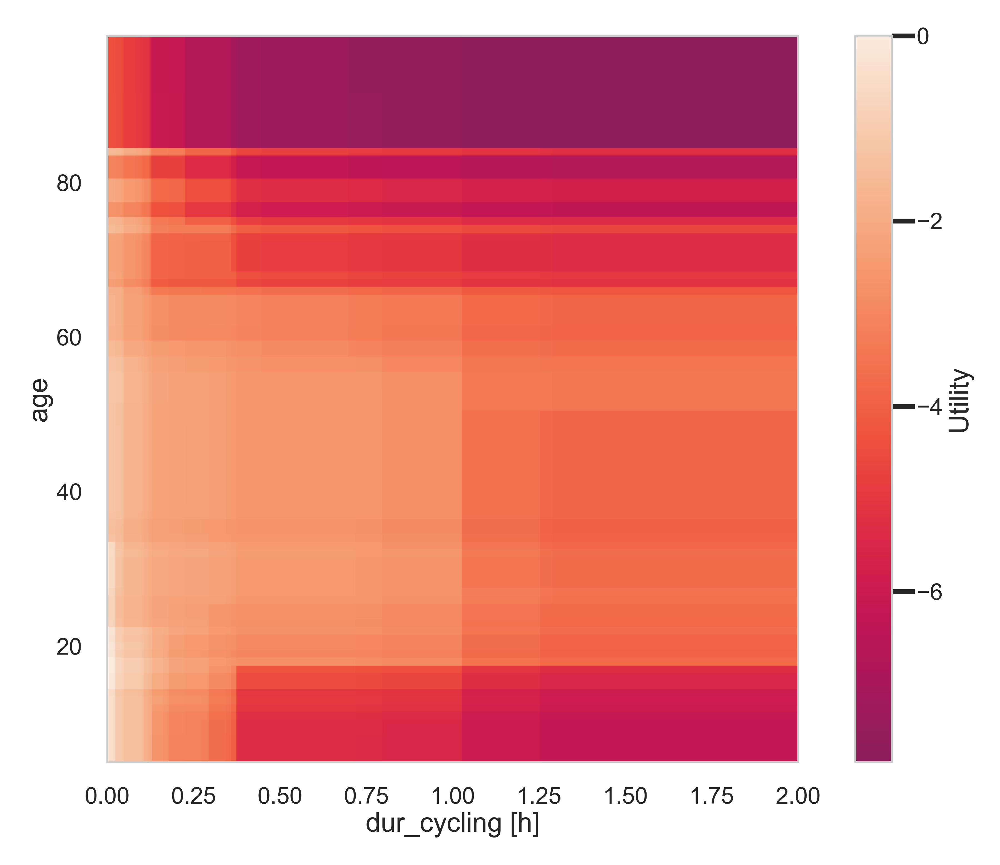

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:110: UserWarning: linewidths is ignored by contourf
  c_plot = axes.contourf(X, Y, contour_plot.T, levels=res, linewidths=0, cmap=customPalette, vmin=-12, vmax=0)


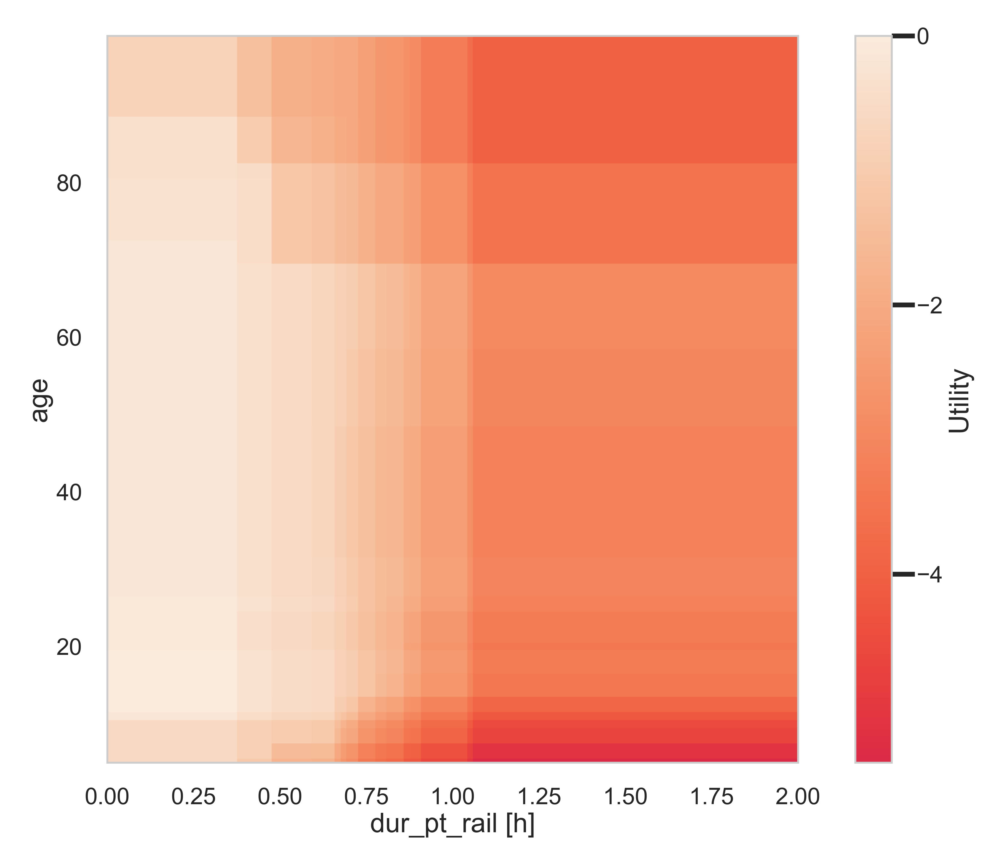

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\utility_plotting.py:110: UserWarning: linewidths is ignored by contourf
  c_plot = axes.contourf(X, Y, contour_plot.T, levels=res, linewidths=0, cmap=customPalette, vmin=-12, vmax=0)


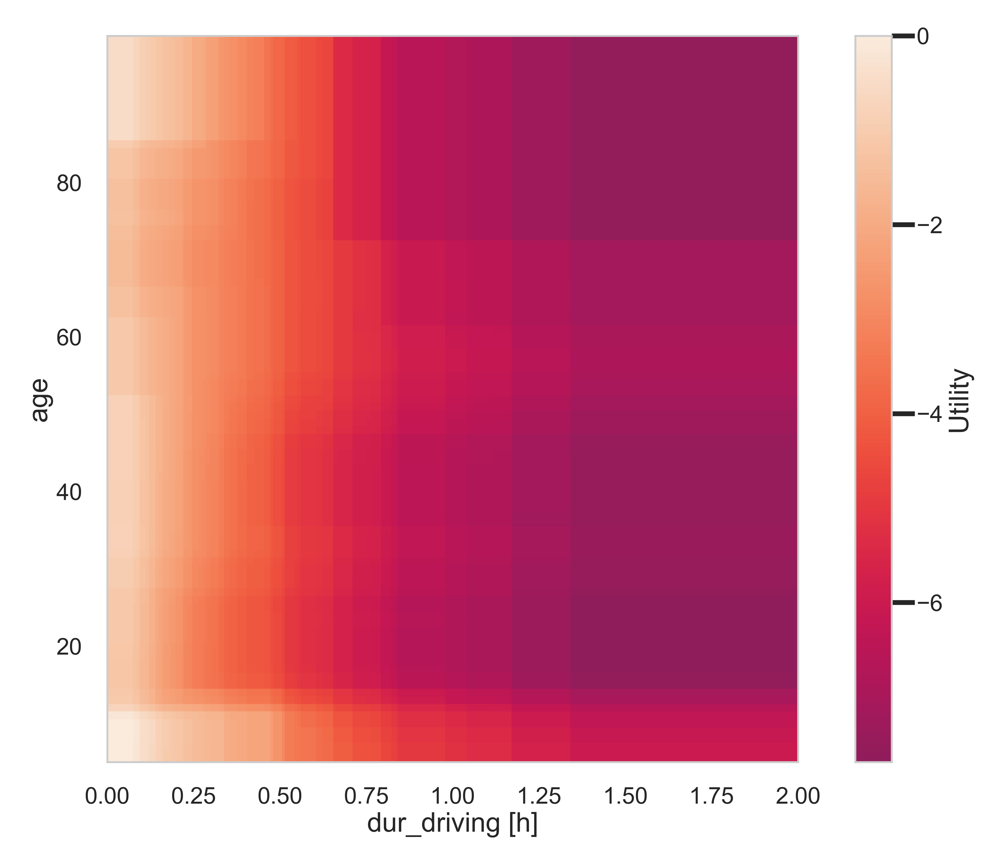

In [43]:
utility_names={'0': 'Walking', '1': 'Cycling', '2':'PT', '3':'Driving'}

plot_2d(LPMCFI_model_fully_trained, 'dur_walking', 'age', 0, 2, LPMC_train['age'].min(), LPMC_train['age'].max(), num_points=1000, save_figure=False)
plot_2d(LPMCFI_model_fully_trained, 'dur_cycling', 'age', 0, 2, LPMC_train['age'].min(), LPMC_train['age'].max(), num_points=1000, save_figure=False)
plot_2d(LPMCFI_model_fully_trained, 'dur_pt_rail', 'age', 0, 2, LPMC_train['age'].min(), LPMC_train['age'].max(), num_points=1000, save_figure=False)
plot_2d(LPMCFI_model_fully_trained, 'dur_driving', 'age', 0, 2, LPMC_train['age'].min(), LPMC_train['age'].max(), num_points=1000, save_figure=False)

## Cross-Nested Logit /!\ IN DEVELOPMENT /!\

We test here a cross-nested logit model where the two nests are motorized and flexible. As this is a work in progress, we just arbitrarily choose values of mu and alphas. This will be later chosen with hyperparameter tuning.

In [44]:
mu = [1.25, 1.16] #random values

alphas  =np.array([[0, 1],
        [0, 1],
        [1, 0],
        [0.5, 0.5]])

In [45]:
%autoreload 2
_, _, folds = load_preprocess_LPMC()

ce_loss = 0
num_trees = 0
for i, (train_idx, test_idx) in enumerate(folds):
    train_set = lgb_train_set.subset(sorted(train_idx))
    test_set = lgb_train_set.subset(sorted(test_idx))

    # Create the classifier
    param = copy.deepcopy(params)
    rum_structure = bio_to_rumboost(LPMC_model)

    print('-'*50 + '\n')
    print(f'Iteration {i+1}')
    LPMC_model_trained = rum_train(param,train_set,rum_structure=rum_structure, valid_sets = [test_set], mu=mu, alphas=alphas)
    ce_loss += LPMC_model_trained.best_score
    num_trees += LPMC_model_trained.best_iteration
    print('-'*50 + '\n')
    print(f'Best cross entropy loss: {LPMC_model_trained.best_score}')
    print(f'Best number of trees: {LPMC_model_trained.best_iteration}')

ce_loss = ce_loss/5
num_trees = num_trees/5
print('-'*50 + '\n')
print(f'Cross validation negative cross entropy loss: {ce_loss}')
print(f'With a number of trees on average of {num_trees}')

--------------------------------------------------

Iteration 1


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------

Best cross entropy loss: 0.6560824787160351
Best number of trees: 687
--------------------------------------------------

Iteration 2


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------

Best cross entropy loss: 0.6444866813873578
Best number of trees: 687
--------------------------------------------------

Iteration 3


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------

Best cross entropy loss: 0.6594268117163683
Best number of trees: 687
--------------------------------------------------

Iteration 4


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------

Best cross entropy loss: 0.6633328079905507
Best number of trees: 687
--------------------------------------------------

Iteration 5


c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\ucesnjs\anaconda32\envs\lightgbm\Lib\site-packages\lightgbm\basic.py:

Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
Finished loading model, total used 687 iterations
--------------------------------------------------

Best cross entropy loss: 0.6666172963883393
Best number of trees: 683
--------------------------------------------------

Cross validation negative cross entropy loss: 0.6579892152397303
With a number of trees on average of 686.2


In [46]:

params = {'n_jobs': -1,
          'num_classes':4,
          'objective':'multiclass',
          'boosting': 'gbdt',
          'monotone_constraints_method': 'advanced',
          'verbosity': -1,
          'num_iterations':686,
          #'early_stopping_round':100,
          'learning_rate':0.1,
          'max_depth':1
          }

LPMCCN_model_fully_trained = rum_train(params, lgb_train_set, rum_structure, mu=mu, alphas=alphas)

preds, _, _ = LPMCCN_model_fully_trained.predict(lgb_test_set, mu=mu, alphas=alphas)

ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

c:\Users\ucesnjs\OneDrive - University College London\Documents\PhD - UCL\rumboost\example\..\rumboost\rumboost.py:825: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


Finished loading model, total used 686 iterations
Finished loading model, total used 686 iterations
Finished loading model, total used 686 iterations
Finished loading model, total used 686 iterations
--------------------------------------------------
Final negative cross-entropy on the test set: 0.6796725053458201
